In [1]:
import sys
sys.path.append("/clusterdata/uqxtan9/Xiao/Q1851/Xiao/Github/SkinCancerConceptVectors")
import stlearn as st
st.settings.set_figure_params(dpi=300)
from pathlib import Path
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib
file = Path("../stimage").resolve()
parent= file.parent
sys.path.append(str(parent))
from PIL import Image
from stimage._utils import gene_plot, Read10X, ReadOldST, tiling
from stimage._model import CNN_NB_multiple_genes
from stimage._data_generator import DataGenerator
import tensorflow as tf
import seaborn as sns
sns.set_style("white")
from scipy import stats
from anndata import read_h5ad
import numpy as np
from tensorflow import keras 

In [93]:

import numpy as np
import matplotlib.pyplot as plt
import os

import skimage.io as io
import yaml

import tensorflow as tf

from skimage.transform import resize

from tensorflow.keras.callbacks import TensorBoard, Callback
from tensorflow.keras import backend as K

from scipy.spatial.distance import cdist
# from lapjv import lapjv


class Summary(TensorBoard):
    """
    A standard tensorboard call back but includes
    a visualisation call at the end of each epoch
    """
    def __init__(self, test_z, test_batch, img_dir, n, weight_dir, save_all_weights=False, **kwargs):
        """
        :param log_dir - the log directory (including the run name),
        :param write_graph - include the graph?
        :param update_freq - "epoch" "batch" or int(n) batches
        :param test_z: the z vector to test on
        :param test_batch: the x, noise and constant vectors to test on
        :param out_dir: where to save the images (path)
        :param n: how many images to show
        :param weight_dir: where to save the weights (every epoch)
        :param kwargs: kwargs relating to TensorBoard class
        """
        super(Summary, self).__init__(**kwargs)
        self.test_z = test_z
        self.test_batch = test_batch
        self.img_dir = img_dir
        self.n = n
        self.weight_dir = weight_dir
        self.save_all = save_all_weights

    def on_epoch_end(self, epoch, logs=None):
        super().on_epoch_end(epoch, logs)
        print()
        self.visualise_progress(self.test_z, self.test_batch, epoch, self.n)

        self.save_weights(epoch)

        # Reset metrics
        self.model.d_loss_tracker.reset_states()
        self.model.g_loss_tracker.reset_states()
        self.model.r_loss_tracker.reset_states()
        self.model.gp_loss_tracker.reset_states()

    def visualise_progress(self, z_test, test_batch, epoch, n):
        # Generate Random Samples
        samples = self.model.generator([z_test[:n]] + [test_batch[1][:n]] + [test_batch[2][:n]]).numpy()
        # Reconstruction Inputs
        recons = self.model.inference(test_batch).numpy()

        samples = np.clip(samples, 0, 1)
        recons = np.clip(recons, 0, 1)

        dim = test_batch[0].shape[1]
#         # Show progress
#         fig, ax = plt.subplots(3, n, figsize=(n, 3))
#         for i in range(n):
#             ax[0, i].imshow(test_batch[0][i])
#             ax[0, i].axis("off")
#             ax[1, i].imshow(recons[i])
#             ax[1, i].axis("off")
#             ax[2, i].imshow(samples[i])
#             ax[2, i].axis("off")

#         plt.text(-0.8, 0.4, "Orig.", transform=ax[0, 0].transAxes)
#         plt.text(-1, 0.4, "Recon.", transform=ax[1, 0].transAxes)
#         plt.text(-1.1, 0.4, "Sample", transform=ax[2, 0].transAxes)
        
        # Show progress
        fig, ax = plt.subplots(3, n//3, figsize=(n//3, 3))
        for i in range(n):
            
            ax[i//3, i%3].imshow(recons[i])
            ax[i//3, i%3].axis("off")


        if self.model.fade:
            alpha = self.model.G.get_layer('Fade_G').alpha.value().numpy()
            m = f" - alpha: {alpha:.3}"
        else:
            m = ""
        plt.text(0, 1.2, f"{epoch:04d}{m}", transform=ax[0, 0].transAxes)

        if self.model.fade:
            suffix = "_merge"
        else:
            suffix = ""

        fname = os.path.join(self.img_dir, f"recons_{dim:04d}{suffix}_{epoch:04d}.png")
        plt.savefig(fname, dpi=300)
        print("Plot saved at", fname)
        plt.close()
        
        # Show progress
        fig, ax = plt.subplots(3, n//3, figsize=(n//3, 3))
        for i in range(n):
            
            ax[i//3, i%3].imshow(test_batch[0][i])
            ax[i//3, i%3].axis("off")


        if self.model.fade:
            alpha = self.model.G.get_layer('Fade_G').alpha.value().numpy()
            m = f" - alpha: {alpha:.3}"
        else:
            m = ""
        plt.text(0, 1.2, f"{epoch:04d}{m}", transform=ax[0, 0].transAxes)

        if self.model.fade:
            suffix = "_merge"
        else:
            suffix = ""

        fname = os.path.join(self.img_dir, f"test_batch_{dim:04d}{suffix}_{epoch:04d}.png")
        plt.savefig(fname, dpi=300)
        print("Plot saved at", fname)
        plt.close()
        

    def save_weights(self, epoch):
        if not self.save_all:
            epoch = -1

        if self.model.fade:
            suffix = "_merge_weights"
        else:
            suffix = "_weights"

        out_dir = os.path.join(self.weight_dir, f"Epoch_{epoch:03d}")
        if not os.path.exists(out_dir):
            os.mkdir(out_dir)

        # Save weights and losses
        DIM = self.model.x_dim
        self.model.G.save_weights(os.path.join(out_dir, f"G_{DIM}x{DIM}{suffix}.h5"))
        self.model.E.save_weights(os.path.join(out_dir, f"E_{DIM}x{DIM}{suffix}.h5"))
        self.model.F.save_weights(os.path.join(out_dir, f"F_{DIM}x{DIM}{suffix}.h5"))
        self.model.D.save_weights(os.path.join(out_dir, f"D_{DIM}x{DIM}{suffix}.h5"))
        print("Weights Saved. - ", out_dir)


class ExponentialMovingAverage(Callback):
    """
    Inspired by # https://gist.github.com/soheilb/c5bf0ba7197caa095acfcb69744df756
    """
    def __init__(self,  generator, weight_dir, fid_dir, save_images=False, k=10_000, decay=0.999):
        self.data = generator
        self.weight_dir = weight_dir
        self.fid_dir = fid_dir
        self.decay = decay
        self.save_images = save_images
        self.k = k
        super(ExponentialMovingAverage, self).__init__()

    def on_train_begin(self, logs={}):
        super().on_train_begin(logs)
        # Create a copy of the generator weights
        self.F_ema = {x.name: K.get_value(x) for x in self.model.θ_F}
        self.G_ema = {x.name: K.get_value(x) for x in self.model.θ_G}
        print('Created a copy of model weights to initialize moving averaged weights.')

    def on_batch_end(self, batch, logs={}):
        for weight in self.model.θ_F:
            ema_t_minus_1 = self.F_ema[weight.name]
            self.F_ema[weight.name] -= (1.0 - self.decay) * (ema_t_minus_1 - K.get_value(weight))
        for weight in self.model.θ_G:
            ema_t_minus_1 = self.G_ema[weight.name]
            self.G_ema[weight.name] -= (1.0 - self.decay) * (ema_t_minus_1 - K.get_value(weight))

    def on_epoch_end(self, epoch, logs={}):
        self.orig_F_weights = {x.name: K.get_value(x) for x in self.model.θ_F}
        self.orig_G_weights = {x.name: K.get_value(x) for x in self.model.θ_G}

        # Set weights and save model
        for weight in self.model.θ_F:
            K.set_value(weight, self.F_ema[weight.name])
        for weight in self.model.θ_G:
            K.set_value(weight, self.G_ema[weight.name])

        # Save Average model
        print("saving EMA weights...")
        DIM = self.model.x_dim
        self.model.F.save_weights(f"{self.weight_dir}/F_{DIM}x{DIM}_ema_{epoch}.h5")
        self.model.G.save_weights(f"{self.weight_dir}/G_{DIM}x{DIM}_ema_{epoch}.h5")

        # Epoch Output directory
        output_dir = os.path.join(self.fid_dir, f"EPOCH_{epoch}")
        if not os.path.exists(output_dir):
            os.mkdir(output_dir)

        # Predict stuff
        if self.save_images:
            # Save only 10th epoch
            if epoch % 10 == 0:
                print("Generating Images for FID...")
                progress = tf.keras.utils.Progbar(self.k)
                count = 0
                while count < self.k:
                    x, noise, constant = next(self.data.as_numpy_iterator())
                    preds = (self.model.inference([x, noise, constant]).numpy().clip(0, 1)*255.).astype("uint8")
                    for pred in preds:
                        fname = os.path.join(output_dir, f"{DIM}x{DIM}_{count:04}.jpg")
                        io.imsave(fname, pred)
                        count += 1
                        progress.update(count)

        print("Reloading original weights for next epoch")
        # Reload original weights
        for weight in self.model.θ_F:
            K.set_value(weight, self.orig_F_weights[weight.name])
        for weight in self.model.θ_G:
            K.set_value(weight, self.orig_G_weights[weight.name])


class ConfigParser(object):
    def __init__(self, config_file):
        """
        Parse the YAML config file for the run. All the keys
        :param config_file: path and name of config file
        """
        self._config = yaml.load(open(config_file, 'r').read(),
                                         Loader=yaml.FullLoader)
        # Add attributes
        for key in self._config:
            setattr(self, key, self._config[key])

    def __dir__(self):
        return list(self._config.keys())


# def save_2d_projection_grid(img_collection, X_2d, out_res, out_dim):
#     grid = np.dstack(np.meshgrid(np.linspace(0, 1, out_dim), np.linspace(0, 1, out_dim))).reshape(-1, 2)
#     cost_matrix = cdist(grid, X_2d, "sqeuclidean").astype(np.float32)
#     cost_matrix = cost_matrix * (100000 / cost_matrix.max())

#     print(cost_matrix.shape)
#     row_asses, col_asses, _ = lapjv(cost_matrix)
#     grid_jv = grid[col_asses]
#     out = np.ones((out_dim * out_res, out_dim * out_res, 3))

#     for pos, img in zip(grid_jv, img_collection[0:np.square(out_dim)]):
#         h_range = int(np.floor(pos[0] * (out_dim - 1) * out_res))
#         w_range = int(np.floor(pos[1] * (out_dim - 1) * out_res))
#         out[h_range:h_range + out_res, w_range:w_range + out_res] = img

#     return out

In [2]:
# import matplotlib.pyplot as plt
# from libpysal.weights.contiguity import Queen
# from libpysal import examples
# import numpy as np
# import pandas as pd
# import geopandas as gpd
# import os
# import splot
# from splot.esda import moran_scatterplot, lisa_cluster
# from esda.moran import Moran, Moran_Local
# from esda.moran import Moran_BV, Moran_Local_BV
# from splot.esda import plot_moran_bv_simulation, plot_moran_bv, plot_local_autocorrelation

In [3]:
from StyleALAE.models import *
from StyleALAE.optimizers import *
from StyleALAE.data import *
from StyleALAE.utils import *

In [4]:
import argparse
import matplotlib.pyplot as plt
import os
import pickle
import logging
import datetime

In [22]:
from scipy import stats

def plot_correlation(df, attr_1, attr_2):
    r = stats.pearsonr(df[attr_1], 
                       df[attr_2])[0] **2

    g = sns.lmplot(data=df,
        x=attr_1, y=attr_2,
        height=5, legend=True
    )
    # g.set(ylim=(0, 360), xlim=(0,360))

    g.set_axis_labels(attr_1, attr_2)
    plt.annotate(r'$R^2:{0:.2f}$'.format(r),
                (max(df[attr_1])*0.9, max(df[attr_2])*0.9))
    return g


def calculate_correlation(attr_1, attr_2):
    r = stats.pearsonr(attr_1, 
                       attr_2)[0]
    return r

def calculate_correlation_2(attr_1, attr_2):
    r = stats.spearmanr(attr_1, 
                       attr_2)[0]
    return r

In [5]:
BASE_PATH = Path("/clusterdata/uqxtan9/Xiao/STimage/dataset/breast_cancer_10x_visium")
TILE_PATH = Path("/tmp") / "tiles"
TILE_PATH.mkdir(parents=True, exist_ok=True)

SAMPLE = "block1"
Sample1 = st.Read10X(BASE_PATH / SAMPLE, 
                  library_id=SAMPLE, 
                  count_file="V1_Breast_Cancer_Block_A_Section_1_filtered_feature_bc_matrix.h5",
                  quality="fulres",)
                  #source_image_path=BASE_PATH / SAMPLE /"V1_Breast_Cancer_Block_A_Section_1_image.tif")
img = plt.imread(BASE_PATH / SAMPLE /"V1_Breast_Cancer_Block_A_Section_1_image.tif", 0)
Sample1.uns["spatial"][SAMPLE]['images']["fulres"] = img

SAMPLE = "block2"
Sample2 = st.Read10X(BASE_PATH / SAMPLE, 
                  library_id=SAMPLE, 
                  count_file="V1_Breast_Cancer_Block_A_Section_2_filtered_feature_bc_matrix.h5",
                  quality="fulres",)
                  #source_image_path=BASE_PATH / SAMPLE /"V1_Breast_Cancer_Block_A_Section_1_image.tif")
img = plt.imread(BASE_PATH / SAMPLE /"V1_Breast_Cancer_Block_A_Section_2_image.tif", 0)
Sample2.uns["spatial"][SAMPLE]['images']["fulres"] = img

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [6]:
gene_list=["SLITRK6", "PGM5", "LINC00645", 
           "TTLL12", "COX6C", "CPB1",
           "KRT5", "MALAT1", "CD74"]
gene_list

['SLITRK6',
 'PGM5',
 'LINC00645',
 'TTLL12',
 'COX6C',
 'CPB1',
 'KRT5',
 'MALAT1',
 'CD74']

In [7]:
for adata in [
    Sample1,
    Sample2,
]:
#     count_df = adata.to_df()
#     count_df[count_df <=1] = 0
#     count_df[count_df >1] = 1
#     adata.X = count_df
#     adata[:,gene_list]
    st.pp.filter_genes(adata,min_cells=3)
#     st.pp.normalize_total(adata)
    st.pp.log1p(adata)
#     st.pp.scale(adata)

    # pre-processing for spot image
    TILE_PATH_ = TILE_PATH / list(adata.uns["spatial"].keys())[0]
    TILE_PATH_.mkdir(parents=True, exist_ok=True)
    tiling(adata, TILE_PATH_, crop_size=256,target_size=256)

Log transformation step is finished in adata.X


Tiling image: 100%|██████████ [ time left: 00:00 ]


Log transformation step is finished in adata.X


Tiling image: 100%|██████████ [ time left: 00:00 ]


In [8]:
from tensorflow import keras
from tensorflow.keras.applications.resnet50 import preprocess_input as preprocess_resnet
from tensorflow.keras.preprocessing import image

class DataGenerator_ALAE_noise(keras.utils.Sequence):
    'Generates data for Keras'

    def __init__(self, adata, dim=(256, 256), n_channels=3, genes=None, aug=False, tile_path="tile_path"):
        'Initialization'
        self.dim = dim
        self.adata = adata
        self.n_channels = n_channels
        self.genes = genes
        self.num_genes = len(genes)
        self.aug = aug
        self.tile_path = tile_path
        self.on_epoch_end()

    def __len__(self):
        'Denotes the number of batches per epoch'
        return int(self.adata.n_obs)

    def __getitem__(self, index):
        'Generate one batch of data'
        # Find list of IDs
        obs_temp = self.adata.obs_names[index]

        # Generate data
        X_img, noise_image, constant = self._load_img(obs_temp)
        y = self._load_label(obs_temp)

        return X_img, noise_image, constant

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        self.indexes = np.arange(self.adata.n_obs)

    def _load_img(self, obs):
        img_path = self.adata.obs.loc[obs, 'tile_path']      
        X_img = tf.io.read_file(img_path)
        X_img = tf.image.decode_jpeg(X_img)
        X_img = tf.image.convert_image_dtype(X_img, tf.float32)
        X_img = tf.image.resize(X_img, [self.dim[0], self.dim[1]])
        noise_image = tf.random.normal([self.dim[0], self.dim[1], 1], mean=0, stddev=1)
        constant = tf.ones([1])
        return X_img, noise_image, constant

    def _load_label(self, obs):
        batch_adata = self.adata[obs, self.genes].copy()

        return tuple([batch_adata.to_df()[i].values for i in self.genes])

    def get_classes(self):
        return self.adata.to_df().loc[:, self.genes]

In [9]:
# class DataGenerator_ALAE(keras.utils.Sequence):
#     'Generates data for Keras'

#     def __init__(self, adata, dim=(299, 299), n_channels=3, genes=None, aug=False, tile_path="tile_path"):
#         'Initialization'
#         self.dim = dim
#         self.adata = adata
#         self.n_channels = n_channels
#         self.genes = genes
#         self.num_genes = len(genes)
#         self.aug = aug
#         self.tile_path = tile_path
#         self.on_epoch_end()

#     def __len__(self):
#         'Denotes the number of batches per epoch'
#         return int(self.adata.n_obs)

#     def __getitem__(self, index):
#         'Generate one batch of data'
#         # Find list of IDs
#         obs_temp = self.adata.obs_names[index]

#         # Generate data
#         X_img = self._load_img(obs_temp)
#         y = self._load_label(obs_temp)

#         return X_img, X_img, y

#     def on_epoch_end(self):
#         'Updates indexes after each epoch'
#         self.indexes = np.arange(self.adata.n_obs)

#     def _load_img(self, obs):
#         img_path = self.adata.obs.loc[obs, 'tile_path']
#         X_img = image.load_img(img_path, target_size=self.dim)
#         X_img = image.img_to_array(X_img).astype('float64')
#         #         X_img = np.expand_dims(X_img, axis=0)
#         #         n_rotate = np.random.randint(0, 4)
#         #         X_img = np.rot90(X_img, k=n_rotate, axes=(1, 2))
#         if self.aug:
#             X_img = seq_aug(image=X_img)
# #         X_img = preprocess_resnet(X_img)
#         X_img /= 255.0
#         return X_img

#     def _load_label(self, obs):
#         batch_adata = self.adata[obs, self.genes].copy()

#         return tuple([batch_adata.to_df()[i].values for i in self.genes])

#     def get_classes(self):
#         return self.adata.to_df().loc[:, self.genes]

In [52]:
config = ConfigParser("/clusterdata/uqxtan9/Q1851/Xiao/Github/SkinCancerConceptVectors/StyleALAE/configs/histology_256.yaml")

In [58]:
# MODEL HYPER-PARAMETERS
X_DIM = 4                                # NOTE: Always start from 4x4
Z_DIM = config.z_dim                     # The size of the latent vector
F_N_LAYERS = config.F_layers             # The number of layers in the F (mapping) network
D_N_LAYERS = config.D_layers             # The number of layers in the D (discriminator) network
BASE_FEATURES = config.base_features     # The number of features in the 4x4 base feature space
LEVELS = config.levels                   # The number of levels in training e.g. len([4, 8, 16, 32, 64]) == 5
BATCH_SIZES = config.batch_sizes         # The batch size for each level
ALPHA = config.alpha                     # The learning rate - recommend 0.0015-0.003
GAMMAS = config.gammas                   # The Gradient-Penalty gamma values for each level [0.1, 0.1, 10, ...]
FILTERS = config.filters                 # The convolutional filters for each level
N = config.n                             # The number of images in data set
K_IMAGES = config.k_images               # The number of images to train per level (500K-800K)
EPOCHS = 64              # The number of epochs to train to reach K_IMAGES
BLOCK_TYPE = "AdaIN"           # Block use "AdaIn" or "ModDemod"
RESUME_LEVEL = 7     # The level to resume training at. (None = Train from scratch)

In [59]:
# INPUT & OUTPUT
# DATA_DIR = config.data_dir               # The data directory containing only png/jpg/tif files
RUN_DIR = "/clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test"                # The directory containing all output for particular run
LOG_DIR = os.path.join(RUN_DIR, "logs/")
OUT_DIR = os.path.join(RUN_DIR, "output/")
WEIGHT_DIR = os.path.join(RUN_DIR, "weights/")
FID_DIR = os.path.join(RUN_DIR, "fid/")

# Build Directories
for PATH in [RUN_DIR, LOG_DIR, OUT_DIR, WEIGHT_DIR, FID_DIR]:
    if not os.path.exists(PATH):
        os.mkdir(PATH)
        print(f"Creating dir: {PATH}")
        if PATH == "fid":
            os.mkdir(os.path.join(PATH, "real/"))
            os.mkdir(os.path.join(PATH, "fake/"))
        elif PATH != RUN_DIR or PATH != FID_DIR:
            # create run folders for each level
            for level in range(1, LEVELS + 1):
                dim = 2 ** (level + 1)
                os.mkdir(os.path.join(PATH, f"{dim}x{dim}/"))

In [60]:
tf.get_logger().setLevel(logging.ERROR)

In [61]:
# Create Strategy
strategy = tf.distribute.MirroredStrategy()
print('Number of devices: {}'.format(strategy.num_replicas_in_sync))
# Everything that creates variables should be under the strategy scope.


Number of devices: 4


In [94]:
for level in range(1, LEVELS + 1):

    K.clear_session()

    # TIME RUN
    start = datetime.datetime.now()
    
    batch_s = BATCH_SIZES[level - 1]
    # Show Level parameters
    X_DIM = 2 ** (level + 1)
    print(f"Level: {level}",
          f"DIM: {X_DIM}",
          f"Batch Size: {BATCH_SIZES[level - 1]}",
            f"GAMMA: {GAMMAS[level - 1]}", sep="\t\t")
    # Create Strategy
    strategy = tf.distribute.MirroredStrategy()
    print('Number of devices: {}'.format(strategy.num_replicas_in_sync))
    # Everything that creates variables should be under the strategy scope.
    with strategy.scope():
        # RESUME TRAINING AT THIS LEVEL?
        if RESUME_LEVEL and level < RESUME_LEVEL:
            print(f"...skipping training at level {level} - {X_DIM}x{X_DIM}")
            continue
        else:
            # Create dataset
            n_genes = len(gene_list)
            # training_index = Sample1.obs.sample(frac=0.7, random_state=1).index
            # training_dataset = Sample1[training_index,].copy()
    
            # valid_index = Sample1.obs.index.isin(training_index)
            # valid_dataset = Sample1[~valid_index,].copy()

#             training_index = Sample1.obs.index
#             training_dataset = Sample1[training_index,].copy()

#             valid_index = Sample1.obs.sample(frac=0.3, random_state=1).index
#             valid_dataset = Sample1[valid_index,].copy()


#             test_dataset = Sample2.copy()

#             train_gen = tf.data.Dataset.from_generator(
#                 lambda:DataGenerator_ALAE_noise(adata=training_dataset, 
#                           genes=gene_list, aug=False, dim=(X_DIM, X_DIM)),
#                 output_types=(tf.float32, tf.float32, tf.float32),
#                 output_shapes=([X_DIM,X_DIM,3], [X_DIM,X_DIM,1], [1])
#                 )
#             train_gen_ = train_gen.shuffle(buffer_size=500, reshuffle_each_iteration=True).cache().batch(batch_s).prefetch(tf.data.experimental.AUTOTUNE)
#             valid_gen = tf.data.Dataset.from_generator(
#                 lambda:DataGenerator_ALAE_noise(adata=valid_dataset, 
#                           genes=gene_list, dim=(X_DIM, X_DIM)), 
#                 output_types=(tf.float32, tf.float32, tf.float32),
#                 output_shapes=([X_DIM,X_DIM,3], [X_DIM,X_DIM,1], [1])
#                 )
#             valid_gen_ = valid_gen.shuffle(buffer_size=500, reshuffle_each_iteration=True).cache().batch(batch_s).prefetch(tf.data.experimental.AUTOTUNE)
#             test_gen = tf.data.Dataset.from_generator(
#                 lambda:DataGenerator_ALAE_noise(adata=test_dataset, 
#                           genes=gene_list, dim=(X_DIM, X_DIM)), 
#                 output_types=(tf.float32, tf.float32, tf.float32),
#                 output_shapes=([X_DIM,X_DIM,3], [X_DIM,X_DIM,1], [1])
#                 )
#             test_gen_ = test_gen.batch(1)

            # Get test data - is the same for each run!
            tf.random.set_seed(1234)
            test_z = tf.random.normal((9, Z_DIM), seed=1)
            test_batch = get_test_batch(valid_gen_)



        # ------------------ BUILD MODEL ------------------- #

        # MODELS
        F = build_F(F_N_LAYERS, Z_DIM)
        G = build_base_generator(z_dim=Z_DIM, base_features=BASE_FEATURES, block_type=BLOCK_TYPE)
        E = build_base_encoder(z_dim=Z_DIM, filters=FILTERS[1])
        D = build_D(D_N_LAYERS, Z_DIM)

        # Expand models as needed
        models = []
        if level == 1:
            # Build composite model
            alae = ALAE(x_dim=X_DIM,
                        z_dim=Z_DIM,
                        f_model=F,
                        g_model=G,
                        e_model=E,
                        d_model=D,
                        merge=False)

            # Optimizers
            Adam_D, Adam_G, Adam_R = create_optimizers(α=ALPHA, β1=0.0, β2=0.99)

            alae.compile(d_optimizer=Adam_D,
                         g_optimizer=Adam_G,
                         r_optimizer=Adam_R,
                         γ=GAMMAS[level - 1],
                         alpha_step=None)

            models.append(alae)

            # RESUME TRAINING AT THIS LEVEL?
            if RESUME_LEVEL:
                if level < RESUME_LEVEL:
                    print(f"...skipping training at level {level} - {X_DIM}x{X_DIM}")
                    continue
                    
        # --------------------------------------------------------------------------------------------- #
        else:  # level > 1
            WEIGHT_LEVEL = level - 1
            OLD_DIM = X_DIM // 2
            OLD_WEIGHT_DIR = os.path.join(WEIGHT_DIR, f"{OLD_DIM}x{OLD_DIM}")
            OLD_WEIGHT_DIR = os.path.join(OLD_WEIGHT_DIR, "Epoch_-01")

            for b in range(2, level + 1):
                # Load weights if pre-trained
                if b - 1 == WEIGHT_LEVEL:
                    F.load_weights(os.path.join(OLD_WEIGHT_DIR, f"F_{OLD_DIM}x{OLD_DIM}_weights.h5"))
                    G.load_weights(os.path.join(OLD_WEIGHT_DIR, f"G_{OLD_DIM}x{OLD_DIM}_weights.h5"))
                    E.load_weights(os.path.join(OLD_WEIGHT_DIR, f"E_{OLD_DIM}x{OLD_DIM}_weights.h5"))
                    D.load_weights(os.path.join(OLD_WEIGHT_DIR, f"D_{OLD_DIM}x{OLD_DIM}_weights.h5"))

                G, G_m = expand_generator(old_model=G, block=b,
                                          filters=FILTERS[b][1], z_dim=Z_DIM,
                                          noise_dim=2 ** (b + 1), block_type=BLOCK_TYPE)

                E, E_m = expand_encoder(old_model=E, #old_dim=[OLD_DIM, OLD_DIM, 3],
                                        filters=FILTERS[b],
                                        block=b,
                                        z_dim=Z_DIM)
            

            # RESUME TRAINING AT THIS LEVEL?
            if RESUME_LEVEL:
                if level < RESUME_LEVEL:
                    print(f"...skipping training at level {level} - {X_DIM}x{X_DIM}")
                    continue

            # Expansion finished
            # Build merge model
            alae_m = ALAE(x_dim=X_DIM,
                          z_dim=Z_DIM,
                          f_model=F,
                          g_model=G_m,
                          e_model=E_m,
                          d_model=D,
                          merge=True)

            # Optimizers
            Adam_D, Adam_G, Adam_R = create_optimizers(α=ALPHA, β1=0.0, β2=0.99)

            alae_m.compile(d_optimizer=Adam_D,
                           g_optimizer=Adam_G,
                           r_optimizer=Adam_R,
                           γ=GAMMAS[level - 1],
                           alpha_step=1 / ((N // BATCH_SIZES[level-1])*EPOCHS)
                           )

            # Build straight model
            alae_s = ALAE(x_dim=X_DIM,
                          z_dim=Z_DIM,
                          f_model=F,
                          g_model=G,
                          e_model=E,
                          d_model=D,
                          merge=False)

            # Optimizers
            Adam_D, Adam_G, Adam_R = create_optimizers(α=ALPHA, β1=0.0, β2=0.99)

            alae_s.compile(d_optimizer=Adam_D,
                           g_optimizer=Adam_G,
                           r_optimizer=Adam_R,
                           γ=GAMMAS[level - 1],
                           alpha_step=None)

            models.extend([alae_m, alae_s])

        # Train models
        for m, alae in enumerate(models):
            # BASE
            if len(models) == 1:
                m = ""
                print("training base model")
            # MERGE + STRAIGHT
            elif len(models) == 2:
                m = "straight" if m else "merge"
                print(f"training {m} model")

            callbacks = [
                Summary(log_dir=os.path.join(LOG_DIR, f"{X_DIM}x{X_DIM}/{m}"),
                    write_graph=False,
                    update_freq=50,  # every n batches
                    test_z=test_z,
                    test_batch=test_batch,
                    img_dir=os.path.join(OUT_DIR, f"{X_DIM}x{X_DIM}/"),
                    n=9,
                    weight_dir=os.path.join(WEIGHT_DIR, f"{X_DIM}x{X_DIM}/"),
                    )
            ]

            # Calculate running average of weights for final straight model
            if m == "straight" and level == LEVELS:
                callbacks.append(
                ExponentialMovingAverage(generator=test_batch,
                    weight_dir=WEIGHT_DIR, fid_dir=FID_DIR)
                )

            alae.fit(x=train_gen_,
#                  steps_per_epoch=N // BATCH_SIZES[level-1],
                 epochs=EPOCHS,
                 callbacks=callbacks
                 )
        # LEVEL COMPLETE
        end = datetime.datetime.now()
        print(f"{X_DIM}x{X_DIM} epoch running time:", end - start)

print("Training Complete.")

Level: 1		DIM: 4		Batch Size: 64		GAMMA: 0.1
Number of devices: 4
...skipping training at level 1 - 4x4
Level: 2		DIM: 8		Batch Size: 64		GAMMA: 0.1
Number of devices: 4
...skipping training at level 2 - 8x8
Level: 3		DIM: 16		Batch Size: 64		GAMMA: 0.1
Number of devices: 4
...skipping training at level 3 - 16x16
Level: 4		DIM: 32		Batch Size: 32		GAMMA: 0.1
Number of devices: 4
...skipping training at level 4 - 32x32
Level: 5		DIM: 64		Batch Size: 32		GAMMA: 0.1
Number of devices: 4
...skipping training at level 5 - 64x64
Level: 6		DIM: 128		Batch Size: 16		GAMMA: 0.1
Number of devices: 4
...skipping training at level 6 - 128x128
Level: 7		DIM: 256		Batch Size: 16		GAMMA: 0.1
Number of devices: 4


2021-11-22 02:42:37.539549: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:184] Filling up shuffle buffer (this may take a while): 14 of 500
2021-11-22 02:42:47.626060: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:184] Filling up shuffle buffer (this may take a while): 28 of 500
2021-11-22 02:42:57.543321: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:184] Filling up shuffle buffer (this may take a while): 42 of 500
2021-11-22 02:43:07.498578: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:184] Filling up shuffle buffer (this may take a while): 56 of 500
2021-11-22 02:43:17.473470: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:184] Filling up shuffle buffer (this may take a while): 70 of 500
2021-11-22 02:43:28.047374: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:184] Filling up shuffle buffer (this may take a while): 85 of 500
2021-11-22 02:43:37.823530: I tensorflow/core/kernels/data/shuffle_dataset_op.cc:184] Filling up shuffle buffer (this 

training merge model


2021-11-22 02:48:52.156354: I tensorflow/core/profiler/lib/profiler_session.cc:159] Profiler session started.
2021-11-22 02:48:52.156491: E tensorflow/core/profiler/internal/gpu/cupti_tracer.cc:1408] function cupti_interface_->Subscribe( &subscriber_, (CUpti_CallbackFunc)ApiCallback, this)failed with error CUPTI_ERROR_NOT_INITIALIZED
2021-11-22 02:48:52.156508: E tensorflow/core/profiler/internal/gpu/cupti_tracer.cc:1447] function cupti_interface_->ActivityRegisterCallbacks( AllocCuptiActivityBuffer, FreeCuptiActivityBuffer)failed with error CUPTI_ERROR_NOT_INITIALIZED
2021-11-22 02:48:52.156531: E tensorflow/core/profiler/internal/gpu/cupti_tracer.cc:1430] function cupti_interface_->EnableCallback( 0 , subscriber_, CUPTI_CB_DOMAIN_DRIVER_API, cbid)failed with error CUPTI_ERROR_INVALID_PARAMETER


Epoch 1/64
      1/Unknown - 0s 49us/step - loss_r: 0.1004 - loss_g: 0.0678 - loss_d: 0.5828 - loss_gp: 0.7552

2021-11-22 02:53:25.724819: I tensorflow/core/profiler/lib/profiler_session.cc:159] Profiler session started.
2021-11-22 02:53:25.724916: E tensorflow/core/profiler/internal/gpu/cupti_tracer.cc:1408] function cupti_interface_->Subscribe( &subscriber_, (CUpti_CallbackFunc)ApiCallback, this)failed with error CUPTI_ERROR_NOT_INITIALIZED
2021-11-22 02:53:25.724937: E tensorflow/core/profiler/internal/gpu/cupti_tracer.cc:1447] function cupti_interface_->ActivityRegisterCallbacks( AllocCuptiActivityBuffer, FreeCuptiActivityBuffer)failed with error CUPTI_ERROR_NOT_INITIALIZED
2021-11-22 02:53:25.986105: E tensorflow/core/profiler/internal/gpu/cupti_tracer.cc:1430] function cupti_interface_->EnableCallback( 0 , subscriber_, CUPTI_CB_DOMAIN_DRIVER_API, cbid)failed with error CUPTI_ERROR_INVALID_PARAMETER
2021-11-22 02:53:25.994345: I tensorflow/core/profiler/internal/gpu/device_tracer.cc:216]  GpuTracer has collected 0 callback api events and 0 activity events.
2021-11-22 02:53:26.194321: I ten

    238/Unknown - 59s 249ms/step - loss_r: 0.1442 - loss_g: 4.0039 - loss_d: 0.6239 - loss_gp: 1.3420
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/recons_0256_merge_0000.png
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/test_batch_0256_merge_0000.png
Weights Saved. -  /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/weights/256x256/Epoch_-01
238/238 [==============================] - 62s 258ms/step - loss_r: 0.1442 - loss_g: 4.0039 - loss_d: 0.6239 - loss_gp: 1.3428
Epoch 2/64
238/238 [==============================] - ETA: 0s - loss_r: 0.1326 - loss_g: 4.8036 - loss_d: 0.5532 - loss_gp: 2.0832
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/recons_0256_merge_0001.png
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_

Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/test_batch_0256_merge_0012.png
Weights Saved. -  /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/weights/256x256/Epoch_-01
238/238 [==============================] - 50s 208ms/step - loss_r: 0.0909 - loss_g: 4.4898 - loss_d: 0.3872 - loss_gp: 2.3645
Epoch 14/64
238/238 [==============================] - ETA: 0s - loss_r: 0.1333 - loss_g: 4.3750 - loss_d: 0.5917 - loss_gp: 2.4047
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/recons_0256_merge_0013.png
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/test_batch_0256_merge_0013.png
Weights Saved. -  /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/weights/256x256/Epoch_-01
238/238 [==============================] - 49s 206ms/step - lo

Epoch 26/64
238/238 [==============================] - ETA: 0s - loss_r: 0.1491 - loss_g: 5.8398 - loss_d: 0.4516 - loss_gp: 2.8778
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/recons_0256_merge_0025.png
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/test_batch_0256_merge_0025.png
Weights Saved. -  /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/weights/256x256/Epoch_-01
238/238 [==============================] - 48s 204ms/step - loss_r: 0.1491 - loss_g: 5.8398 - loss_d: 0.4516 - loss_gp: 2.8778
Epoch 27/64
238/238 [==============================] - ETA: 0s - loss_r: 0.0871 - loss_g: 3.5582 - loss_d: 0.5173 - loss_gp: 1.4415
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/recons_0256_merge_0026.png
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_pr

Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/test_batch_0256_merge_0037.png
Weights Saved. -  /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/weights/256x256/Epoch_-01
238/238 [==============================] - 49s 204ms/step - loss_r: 0.1367 - loss_g: 4.8114 - loss_d: 0.5677 - loss_gp: 2.6585
Epoch 39/64
238/238 [==============================] - ETA: 0s - loss_r: 0.0941 - loss_g: 4.4213 - loss_d: 0.3409 - loss_gp: 2.1359
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/recons_0256_merge_0038.png
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/test_batch_0256_merge_0038.png
Weights Saved. -  /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/weights/256x256/Epoch_-01
238/238 [==============================] - 49s 207ms/step - lo

Epoch 51/64
238/238 [==============================] - ETA: 0s - loss_r: 0.1336 - loss_g: 4.7500 - loss_d: 0.5220 - loss_gp: 2.4709
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/recons_0256_merge_0050.png
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/test_batch_0256_merge_0050.png
Weights Saved. -  /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/weights/256x256/Epoch_-01
238/238 [==============================] - 49s 204ms/step - loss_r: 0.1336 - loss_g: 4.7500 - loss_d: 0.5220 - loss_gp: 2.4698
Epoch 52/64
238/238 [==============================] - ETA: 0s - loss_r: 0.0887 - loss_g: 4.5530 - loss_d: 0.3273 - loss_gp: 2.2221
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/recons_0256_merge_0051.png
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_pr

Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/test_batch_0256_merge_0062.png
Weights Saved. -  /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/weights/256x256/Epoch_-01
238/238 [==============================] - 49s 205ms/step - loss_r: 0.0816 - loss_g: 4.0815 - loss_d: 0.3433 - loss_gp: 1.9051
Epoch 64/64
238/238 [==============================] - ETA: 0s - loss_r: 0.1393 - loss_g: 4.5273 - loss_d: 0.5389 - loss_gp: 2.6952
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/recons_0256_merge_0063.png
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/test_batch_0256_merge_0063.png
Weights Saved. -  /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/weights/256x256/Epoch_-01
238/238 [==============================] - 49s 208ms/step - lo

image/experiments/ALAE_test/logs/256x256/merge/train/plugins/profile/2021_11_22_02_53_25Dumped tool data for overview_page.pb to /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/logs/256x256/merge/train/plugins/profile/2021_11_22_02_53_25/gpunode-1-2.overview_page.pb
Dumped tool data for input_pipeline.pb to /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/logs/256x256/merge/train/plugins/profile/2021_11_22_02_53_25/gpunode-1-2.input_pipeline.pb
Dumped tool data for tensorflow_stats.pb to /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/logs/256x256/merge/train/plugins/profile/2021_11_22_02_53_25/gpunode-1-2.tensorflow_stats.pb
Dumped tool data for kernel_stats.pb to /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/logs/256x256/merge/train/plugins/profile/2021_11_22_02_53_25/gpunode-1-2.kernel_stats.pb

2021-11-22 03:46:19.921525: I tensorflow/core/pro

Epoch 1/64
      1/Unknown - 0s 35us/step - loss_r: 29.4757 - loss_g: 11.1432 - loss_d: 34.9346 - loss_gp: 39.8529

2021-11-22 03:49:57.680844: I tensorflow/core/profiler/lib/profiler_session.cc:159] Profiler session started.
2021-11-22 03:49:57.681617: E tensorflow/core/profiler/internal/gpu/cupti_tracer.cc:1408] function cupti_interface_->Subscribe( &subscriber_, (CUpti_CallbackFunc)ApiCallback, this)failed with error CUPTI_ERROR_NOT_INITIALIZED
2021-11-22 03:49:57.681642: E tensorflow/core/profiler/internal/gpu/cupti_tracer.cc:1447] function cupti_interface_->ActivityRegisterCallbacks( AllocCuptiActivityBuffer, FreeCuptiActivityBuffer)failed with error CUPTI_ERROR_NOT_INITIALIZED
2021-11-22 03:49:57.959048: E tensorflow/core/profiler/internal/gpu/cupti_tracer.cc:1430] function cupti_interface_->EnableCallback( 0 , subscriber_, CUPTI_CB_DOMAIN_DRIVER_API, cbid)failed with error CUPTI_ERROR_INVALID_PARAMETER
2021-11-22 03:49:57.968520: I tensorflow/core/profiler/internal/gpu/device_tracer.cc:216]  GpuTracer has collected 0 callback api events and 0 activity events.
2021-11-22 03:49:58.076152: I ten

    238/Unknown - 65s 272ms/step - loss_r: 0.5976 - loss_g: 1.7080 - loss_d: 1.4722 - loss_gp: 2.9756
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/recons_0256_0000.png
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/test_batch_0256_0000.png
Weights Saved. -  /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/weights/256x256/Epoch_-01
saving EMA weights...
Reloading original weights for next epoch
238/238 [==============================] - 67s 283ms/step - loss_r: 0.5976 - loss_g: 1.7080 - loss_d: 1.4722 - loss_gp: 2.9697
Epoch 2/64
238/238 [==============================] - ETA: 0s - loss_r: 0.1330 - loss_g: 3.4154 - loss_d: 0.5787 - loss_gp: 1.7484
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/recons_0256_0001.png
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/

Weights Saved. -  /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/weights/256x256/Epoch_-01
saving EMA weights...
Reloading original weights for next epoch
238/238 [==============================] - 57s 239ms/step - loss_r: 0.1489 - loss_g: 5.3543 - loss_d: 0.4497 - loss_gp: 2.7460
Epoch 13/64
238/238 [==============================] - ETA: 0s - loss_r: 0.0758 - loss_g: 3.5876 - loss_d: 0.3994 - loss_gp: 1.8259
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/recons_0256_0012.png
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/test_batch_0256_0012.png
Weights Saved. -  /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/weights/256x256/Epoch_-01
saving EMA weights...
Reloading original weights for next epoch
238/238 [==============================] - 57s 240ms/step - loss_r: 0.0758 - loss_g: 3.58

Epoch 24/64
238/238 [==============================] - ETA: 0s - loss_r: 0.1229 - loss_g: 4.7368 - loss_d: 0.5183 - loss_gp: 2.2450
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/recons_0256_0023.png
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/test_batch_0256_0023.png
Weights Saved. -  /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/weights/256x256/Epoch_-01
saving EMA weights...
Reloading original weights for next epoch
238/238 [==============================] - 57s 241ms/step - loss_r: 0.1229 - loss_g: 4.7368 - loss_d: 0.5183 - loss_gp: 2.2442
Epoch 25/64
238/238 [==============================] - ETA: 0s - loss_r: 0.0796 - loss_g: 4.3083 - loss_d: 0.3081 - loss_gp: 2.2556
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/recons_0256_0024.png
Plot saved at /

Weights Saved. -  /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/weights/256x256/Epoch_-01
saving EMA weights...
Reloading original weights for next epoch
238/238 [==============================] - 57s 240ms/step - loss_r: 0.1320 - loss_g: 4.2605 - loss_d: 0.5464 - loss_gp: 2.3933
Epoch 36/64
238/238 [==============================] - ETA: 0s - loss_r: 0.0801 - loss_g: 4.4073 - loss_d: 0.2911 - loss_gp: 2.1565
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/recons_0256_0035.png
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/test_batch_0256_0035.png
Weights Saved. -  /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/weights/256x256/Epoch_-01
saving EMA weights...
Reloading original weights for next epoch
238/238 [==============================] - 57s 239ms/step - loss_r: 0.0801 - loss_g: 4.40

Epoch 47/64
238/238 [==============================] - ETA: 0s - loss_r: 0.1224 - loss_g: 5.0097 - loss_d: 0.4027 - loss_gp: 2.1163
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/recons_0256_0046.png
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/test_batch_0256_0046.png
Weights Saved. -  /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/weights/256x256/Epoch_-01
saving EMA weights...
Reloading original weights for next epoch
238/238 [==============================] - 57s 241ms/step - loss_r: 0.1224 - loss_g: 5.0097 - loss_d: 0.4027 - loss_gp: 2.1165
Epoch 48/64
238/238 [==============================] - ETA: 0s - loss_r: 0.0725 - loss_g: 3.7955 - loss_d: 0.3479 - loss_gp: 1.6589
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/recons_0256_0047.png
Plot saved at /

Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/test_batch_0256_0057.png
Weights Saved. -  /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/weights/256x256/Epoch_-01
saving EMA weights...
Reloading original weights for next epoch
238/238 [==============================] - 58s 242ms/step - loss_r: 0.1261 - loss_g: 3.9230 - loss_d: 0.4744 - loss_gp: 1.9814
Epoch 59/64
238/238 [==============================] - ETA: 0s - loss_r: 0.1333 - loss_g: 4.8744 - loss_d: 0.4540 - loss_gp: 2.2214
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/recons_0256_0058.png
Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/256x256/test_batch_0256_0058.png
Weights Saved. -  /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/weights/256x256/Epoch_-01
saving EMA weigh

ect/STimage/experiments/ALAE_test/logs/256x256/straight/train/plugins/profile/2021_11_22_03_49_57Dumped tool data for overview_page.pb to /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/logs/256x256/straight/train/plugins/profile/2021_11_22_03_49_57/gpunode-1-2.overview_page.pb
Dumped tool data for input_pipeline.pb to /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/logs/256x256/straight/train/plugins/profile/2021_11_22_03_49_57/gpunode-1-2.input_pipeline.pb
Dumped tool data for tensorflow_stats.pb to /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/logs/256x256/straight/train/plugins/profile/2021_11_22_03_49_57/gpunode-1-2.tensorflow_stats.pb
Dumped tool data for kernel_stats.pb to /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/logs/256x256/straight/train/plugins/profile/2021_11_22_03_49_57/gpunode-1-2.kernel_stats.pb



In [157]:
train_gen_1 = train_gen.batch(1)
latent_w_all_train = np.vstack([alae.E(in_data).numpy() for in_data in train_gen_1])
training_dataset.obsm["latent_ALAE256"] = latent_w_all_train
training_dataset.write_h5ad(OUT_DIR+"sample1_latent_ALAE256.h5ad")

... storing 'feature_types' as categorical
... storing 'genome' as categorical


In [80]:
latent_w_all = [alae.E(in_data).numpy() for in_data in test_gen_]

In [84]:
latent_w_all[0].shape

(1, 200)

In [86]:
latent_w_all_mtx = np.vstack(latent_w_all)

In [87]:
latent_w_all_mtx.shape

(3987, 200)

In [88]:
test_dataset.obsm["latent_ALAE256"] = latent_w_all_mtx

In [89]:
OUT_DIR

'/clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/'

In [90]:
test_dataset.write_h5ad(OUT_DIR+"sample2_latent_ALAE256.h5ad")

... storing 'feature_types' as categorical
... storing 'genome' as categorical


In [158]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.applications.densenet import DenseNet121
from tensorflow.keras.applications.inception_v3 import InceptionV3
from tensorflow.keras.applications.mobilenet_v2 import MobileNetV2
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.xception import Xception
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Input, Dropout, Lambda
from tensorflow.keras.models import Model


def negative_binomial_layer(x):
    """
    Lambda function for generating negative binomial parameters
    n and p from a Dense(2) output.
    Assumes tensorflow 2 backend.
    Usage
    -----
    outputs = Dense(2)(final_layer)
    distribution_outputs = Lambda(negative_binomial_layer)(outputs)
    Parameters
    ----------
    x : tf.Tensor
        output tensor of Dense layer
    Returns
    -------
    out_tensor : tf.Tensor
    """

    # Get the number of dimensions of the input
    num_dims = len(x.get_shape())

    # Separate the parameters
    n, p = tf.unstack(x, num=2, axis=-1)

    # Add one dimension to make the right shape
    n = tf.expand_dims(n, -1)
    p = tf.expand_dims(p, -1)

    # Apply a softplus to make positive
    n = tf.keras.activations.softplus(n)

    # Apply a sigmoid activation to bound between 0 and 1
    p = tf.keras.activations.sigmoid(p)

    # Join back together again
    out_tensor = tf.concat((n, p), axis=num_dims - 1)

    return out_tensor


def negative_binomial_loss(y_true, y_pred):
    """
    Negative binomial loss function.
    Assumes tensorflow backend.
    Parameters
    ----------
    y_true : tf.Tensor
        Ground truth values of predicted variable.
    y_pred : tf.Tensor
        n and p values of predicted distribution.
    Returns
    -------
    nll : tf.Tensor
        Negative log likelihood.
    """

    # Separate the parameters
    n, p = tf.unstack(y_pred, num=2, axis=-1)

    # Add one dimension to make the right shape
    n = tf.expand_dims(n, -1)
    p = tf.expand_dims(p, -1)
    
    # Calculate the negative log likelihood
    nll = (
            tf.math.lgamma(n)
            + tf.math.lgamma(y_true + 1)
            - tf.math.lgamma(n + y_true)
            - n * tf.math.log(p)
            - y_true * tf.math.log(1 - p)
    )

    return nll



def CNN_NB_model(n_genes):
    inputs = Input(shape=(200,))
#     outputs = Dropout(0.5)(inputs)
    #     outputs = Dense(512,)(outputs)
    outputs = Dense(100, activation='relu')(inputs)
    #     outputs = Dropout(0.5)(outputs)
    
#     output_layers = Dense(n_genes)(inputs)
    
    output_layers = []
    for i in range(n_genes):
        output = Dense(2)(outputs)
        output_layers.append(Lambda(negative_binomial_layer, name="gene_{}".format(i))(output))

    model = Model(inputs=inputs, outputs=output_layers)

    optimizer = tf.keras.optimizers.Adam(1e-5)

    model.compile(loss=negative_binomial_loss,
                  optimizer=optimizer)
    return model

In [159]:
nb_model = CNN_NB_model(n_genes=len(gene_list))

In [160]:
train_his = nb_model.fit(x=training_dataset.obsm["latent_ALAE256"], 
                         y=tuple([col.T for col in training_dataset[:,gene_list].X.toarray().T]),
                         batch_size=64,
                         epochs=100)

Epoch 1/100
60/60 [==============================] - 0s 6ms/step - loss: 17.8643 - gene_0_loss: 1.1734 - gene_1_loss: 0.6928 - gene_2_loss: 0.8690 - gene_3_loss: 2.4915 - gene_4_loss: 3.3188 - gene_5_loss: 2.0218 - gene_6_loss: 0.4905 - gene_7_loss: 3.4655 - gene_8_loss: 3.3410
Epoch 2/100
60/60 [==============================] - 0s 5ms/step - loss: 17.2510 - gene_0_loss: 1.1637 - gene_1_loss: 0.6928 - gene_2_loss: 0.8676 - gene_3_loss: 2.3712 - gene_4_loss: 3.1752 - gene_5_loss: 2.0056 - gene_6_loss: 0.4782 - gene_7_loss: 3.2852 - gene_8_loss: 3.2115
Epoch 3/100
60/60 [==============================] - 0s 5ms/step - loss: 16.7204 - gene_0_loss: 1.1542 - gene_1_loss: 0.6930 - gene_2_loss: 0.8665 - gene_3_loss: 2.2554 - gene_4_loss: 3.0637 - gene_5_loss: 1.9912 - gene_6_loss: 0.4678 - gene_7_loss: 3.1236 - gene_8_loss: 3.1050
Epoch 4/100
60/60 [==============================] - 0s 4ms/step - loss: 16.2620 - gene_0_loss: 1.1451 - gene_1_loss: 0.6936 - gene_2_loss: 0.8656 - gene_3_loss: 2

60/60 [==============================] - 0s 4ms/step - loss: 12.1540 - gene_0_loss: 1.0060 - gene_1_loss: 0.6162 - gene_2_loss: 0.8228 - gene_3_loss: 1.3578 - gene_4_loss: 2.2594 - gene_5_loss: 1.6903 - gene_6_loss: 0.3820 - gene_7_loss: 1.9099 - gene_8_loss: 2.1096
Epoch 60/100
60/60 [==============================] - 0s 5ms/step - loss: 12.1307 - gene_0_loss: 1.0053 - gene_1_loss: 0.6150 - gene_2_loss: 0.8223 - gene_3_loss: 1.3566 - gene_4_loss: 2.2542 - gene_5_loss: 1.6881 - gene_6_loss: 0.3818 - gene_7_loss: 1.9045 - gene_8_loss: 2.1028
Epoch 61/100
60/60 [==============================] - 0s 4ms/step - loss: 12.1078 - gene_0_loss: 1.0048 - gene_1_loss: 0.6139 - gene_2_loss: 0.8216 - gene_3_loss: 1.3555 - gene_4_loss: 2.2490 - gene_5_loss: 1.6860 - gene_6_loss: 0.3817 - gene_7_loss: 1.8992 - gene_8_loss: 2.0962
Epoch 62/100
60/60 [==============================] - 0s 4ms/step - loss: 12.0855 - gene_0_loss: 1.0041 - gene_1_loss: 0.6128 - gene_2_loss: 0.8209 - gene_3_loss: 1.3545 - g

In [161]:
test_predictions = nb_model.predict(test_dataset.obsm["latent_ALAE256"])
from scipy.stats import nbinom
y_preds = []
for i in range(n_genes):
    n = test_predictions[i][:, 0]
    p = test_predictions[i][:, 1]
    y_pred = nbinom.mean(n, p)
    y_preds.append(y_pred)
test_dataset.obsm["predicted_gene"] = np.array(y_preds).transpose()

In [162]:
test_dataset_ = test_dataset[:,gene_list].copy()
test_dataset_.X = test_dataset_.obsm["predicted_gene"]

SLITRK6


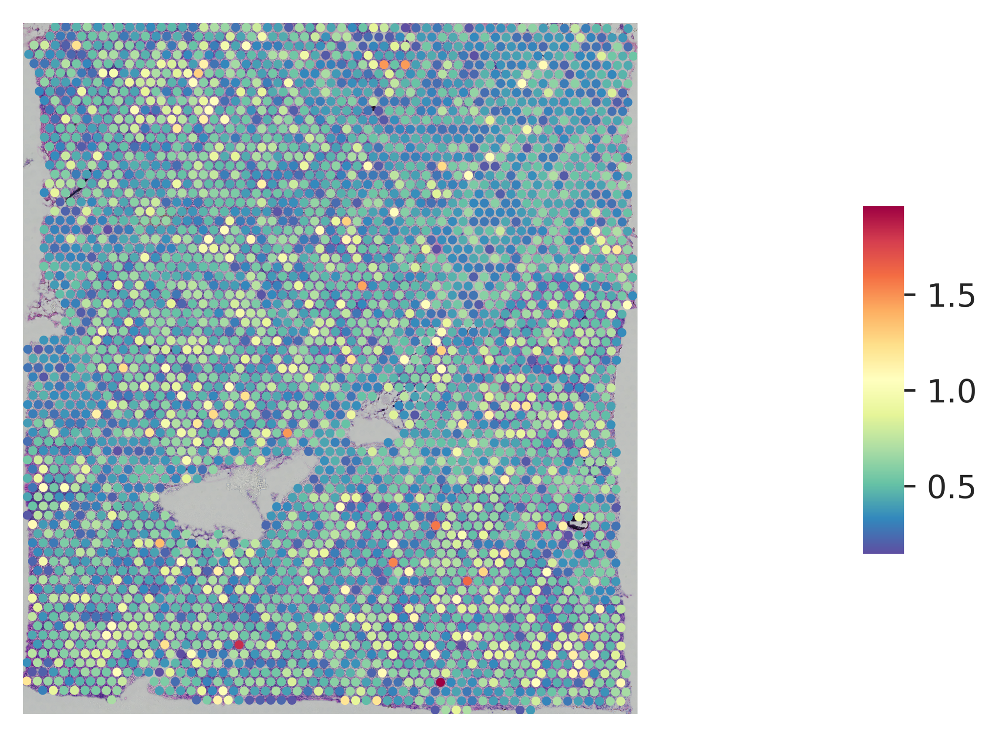

PGM5


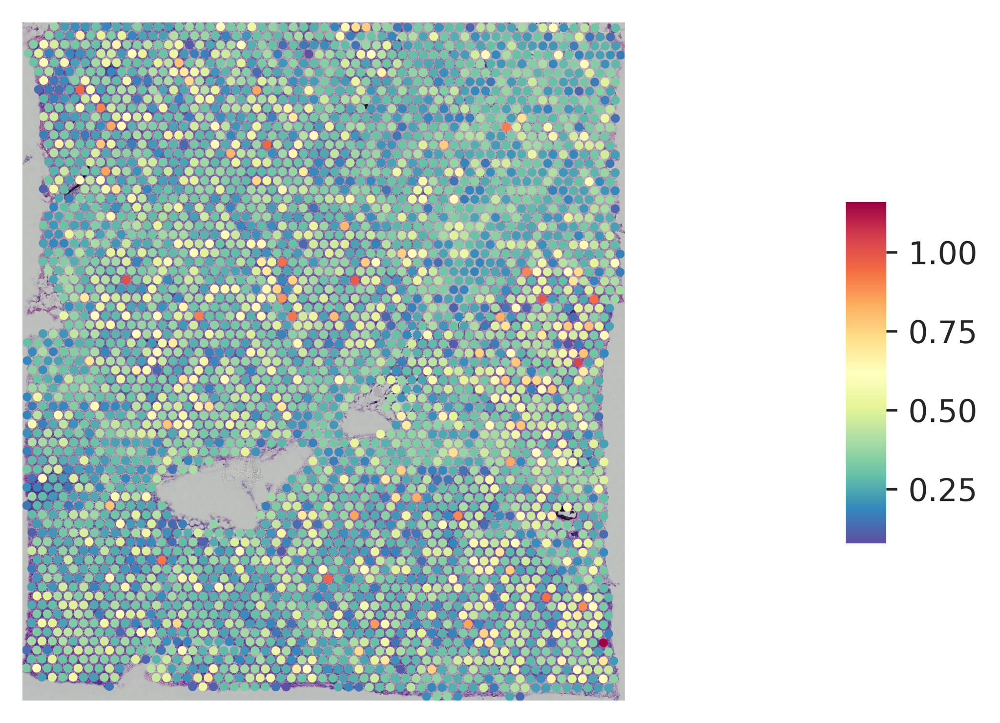

LINC00645


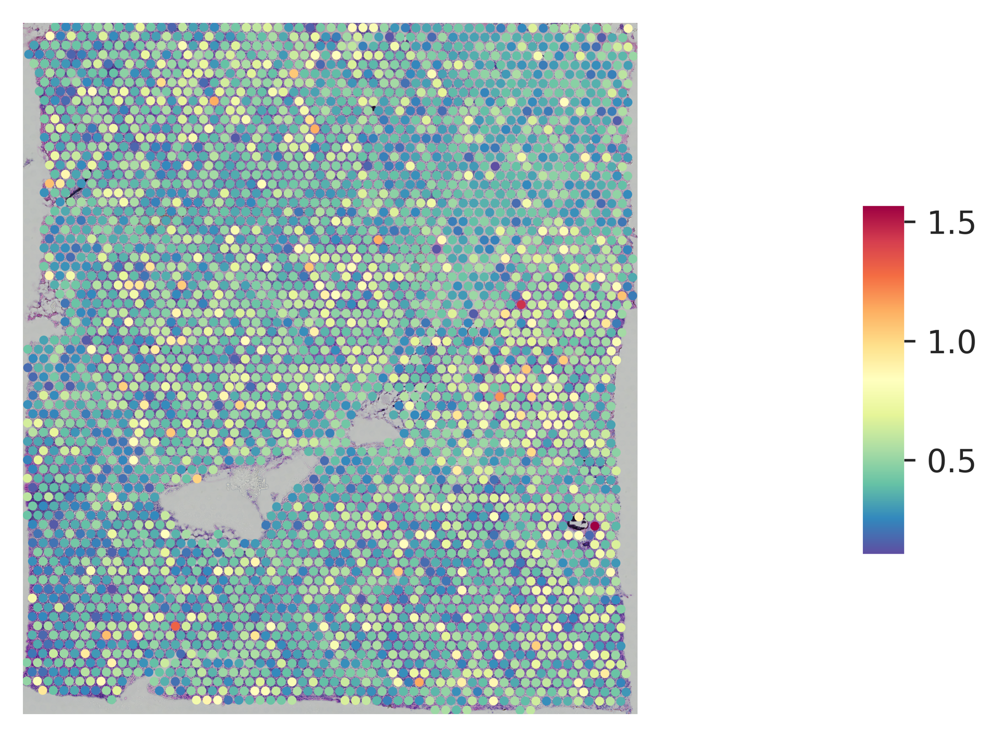

TTLL12


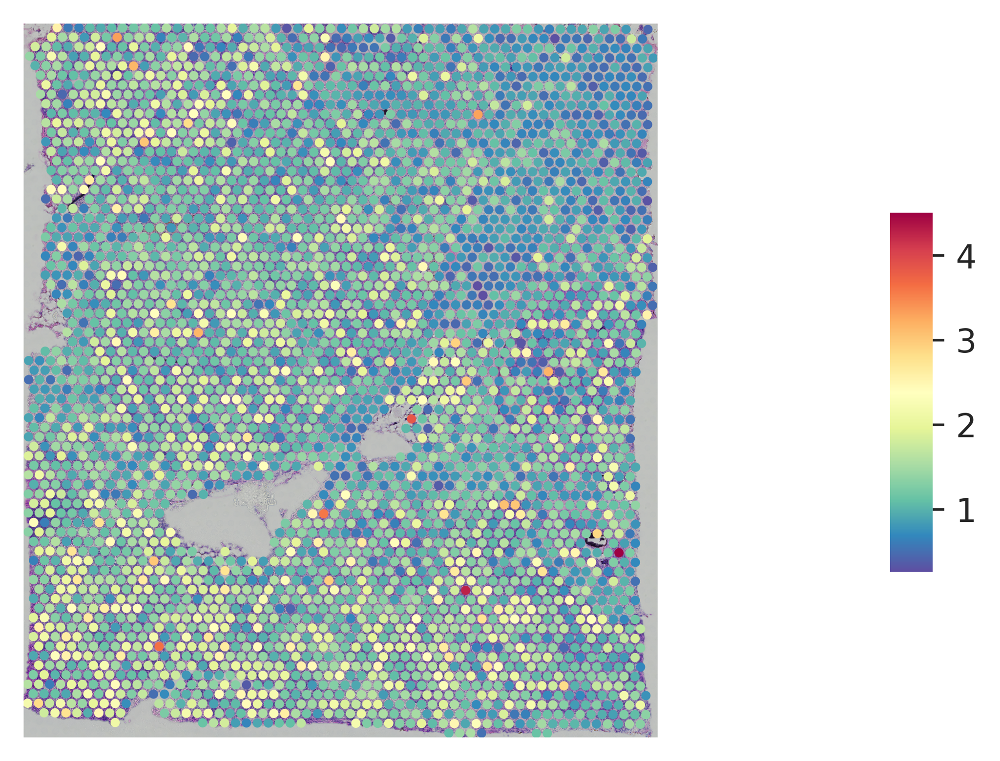

COX6C


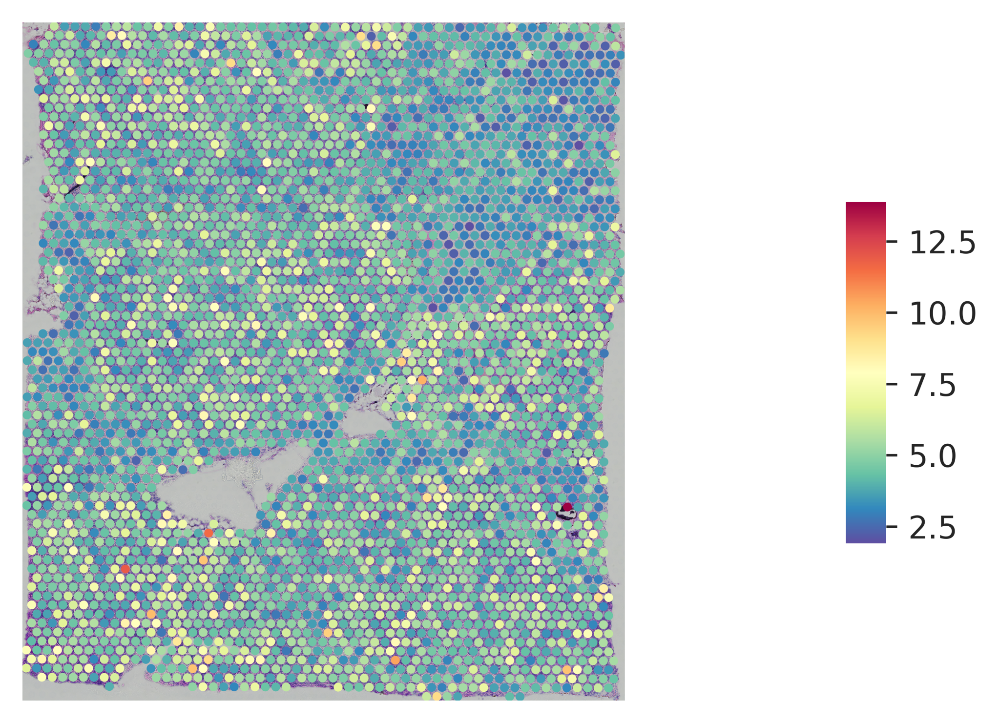

CPB1


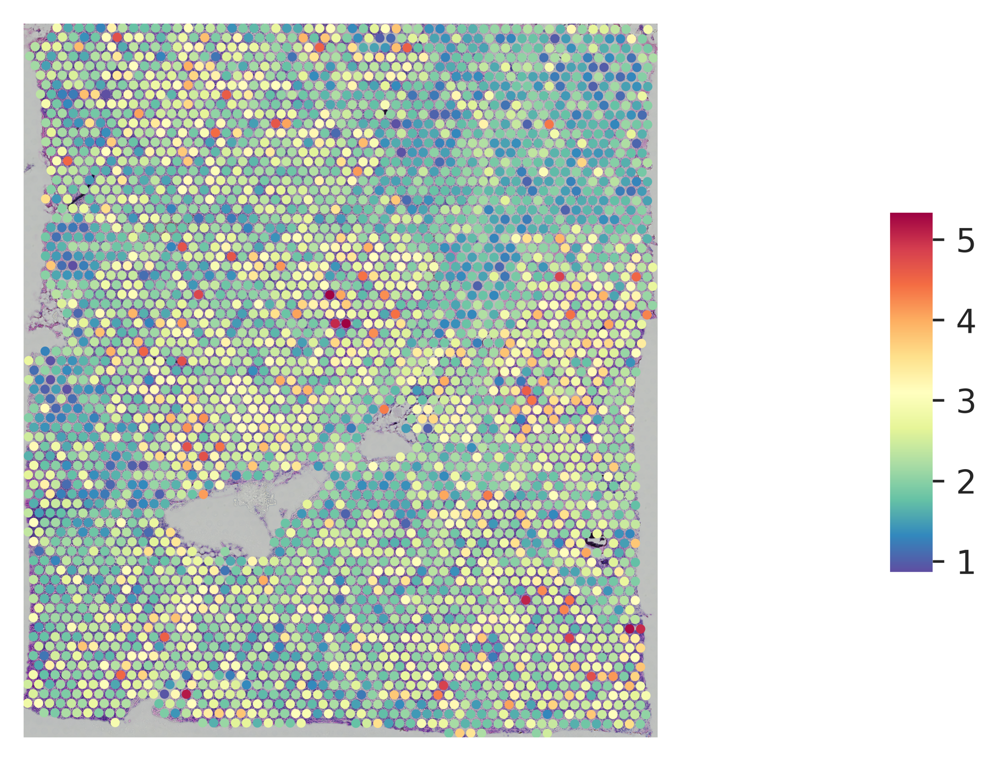

KRT5


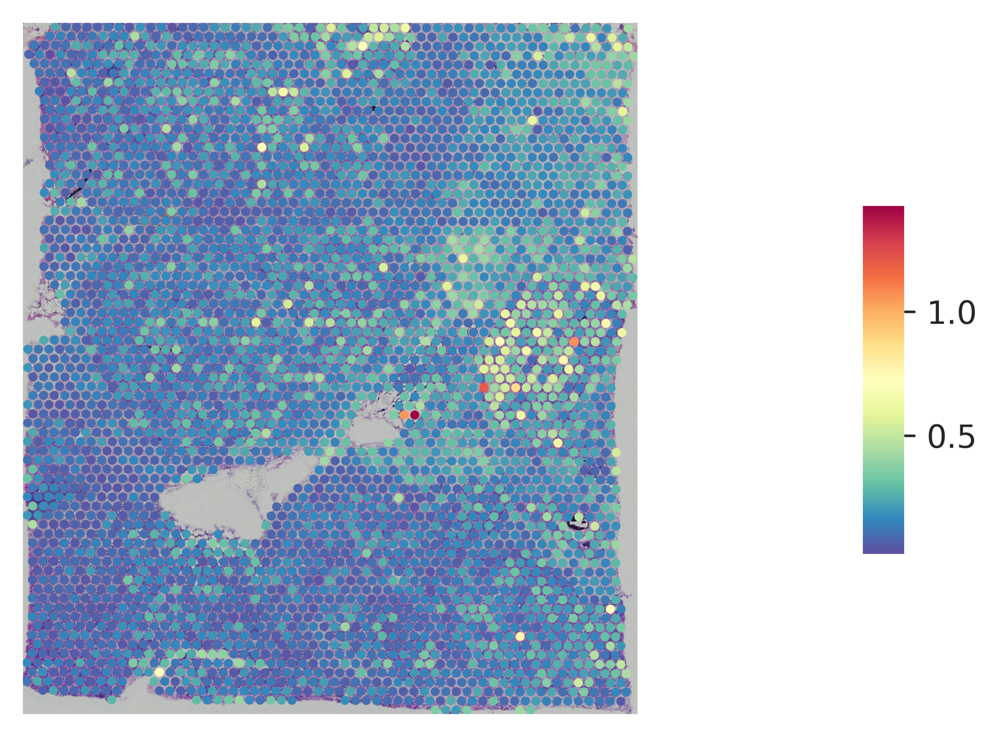

MALAT1


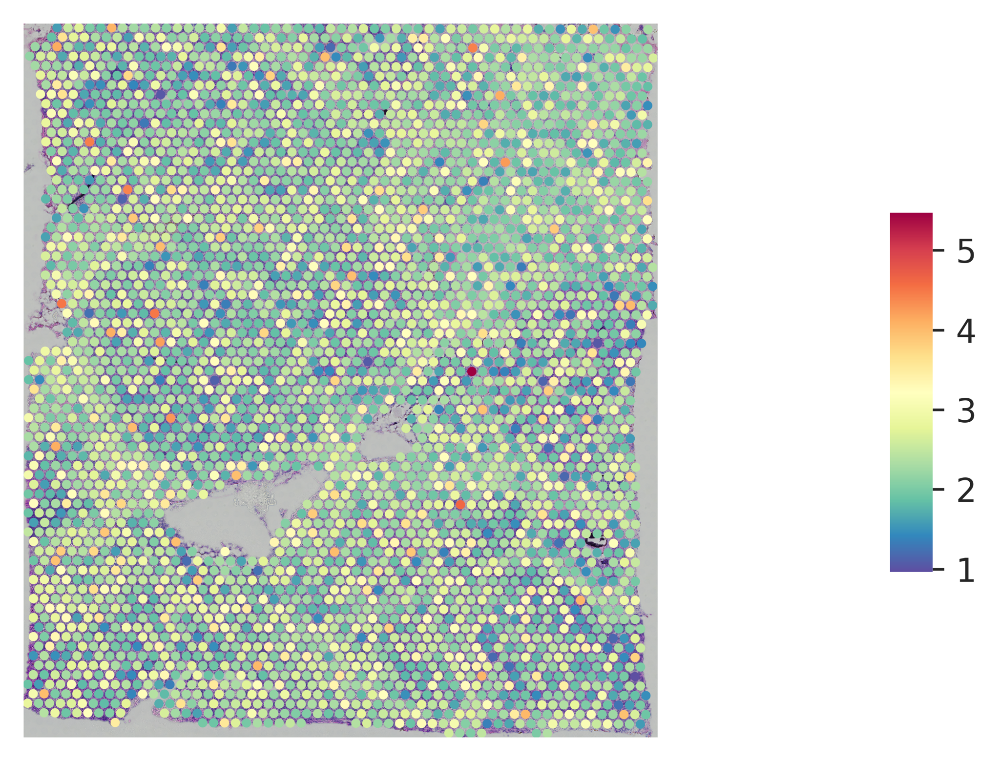

CD74


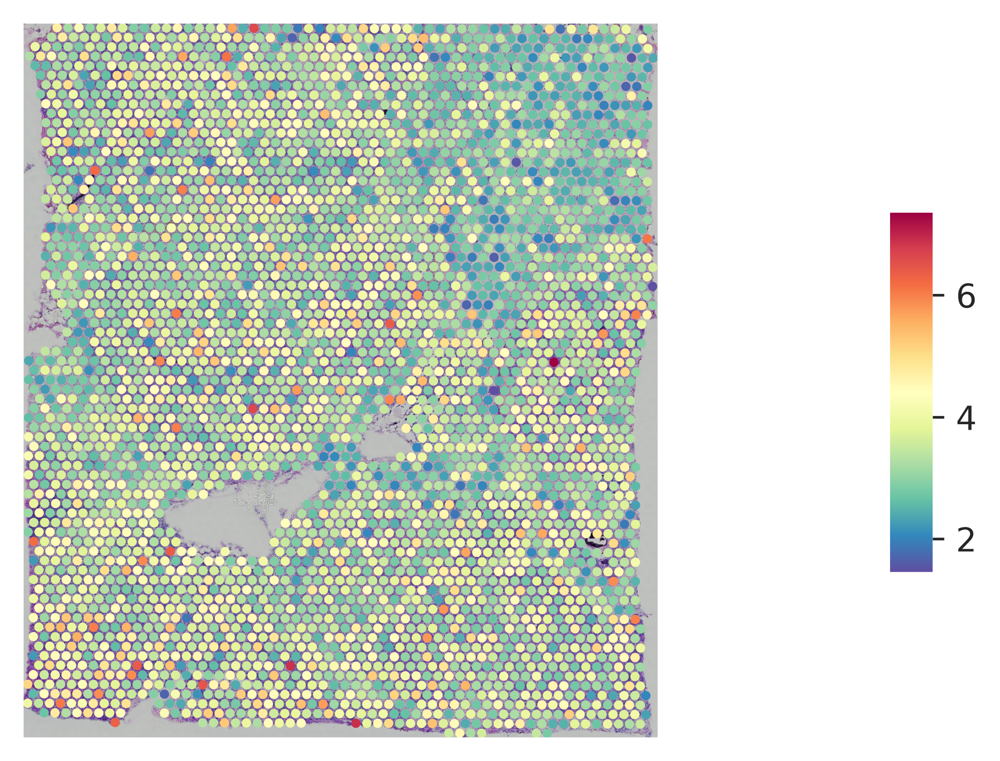

In [163]:
for i in gene_list:
    print(i)
    gene_plot(test_dataset_, genes=i, spot_size=8) 

In [149]:
test_dataset[:,gene_list].X.toarray().shape

(3987, 9)

In [143]:
test_dataset.obsm["latent_ALAE256"].shape

(3987, 200)

In [125]:
tuple([col.T for col in test_dataset.X.T])[1].dtype

dtype('float32')

In [67]:
latent_w = alae.E(test_batch)

In [70]:
latent_w.numpy().shape

(16, 200)

In [66]:
test_batch[2].shape

TensorShape([16, 1])

In [25]:
alae.generator.summary()

Model: "generator"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_4 (InputLayer)            [(None, 200)]        0                                            
__________________________________________________________________________________________________
F (Model)                       (None, 200)          321600      input_4[0][0]                    
__________________________________________________________________________________________________
input_5 (InputLayer)            [(None, 128, 128, 1) 0                                            
__________________________________________________________________________________________________
input_6 (InputLayer)            [(None, 1, 1)]       0                                            
__________________________________________________________________________________________

In [27]:
alae.G.summary()

Model: "G_merged_6"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
G_constant_input (InputLayer)   [(None, 1, 1)]       0                                            
__________________________________________________________________________________________________
G_base (Dense)                  (None, 1, 2048)      4096        G_constant_input[0][0]           
__________________________________________________________________________________________________
G_w_input_1 (InputLayer)        [(None, 200)]        0                                            
__________________________________________________________________________________________________
G_noise_input (InputLayer)      [(None, 128, 128, 1) 0                                            
_________________________________________________________________________________________

In [41]:
test_batch[0].shape

TensorShape([8, 128, 128, 3])

In [42]:
np.__version__

'1.19.5'

In [45]:
import tensorflow_addons as tfa
tfa.__version__

'0.10.0'

In [ ]:
# INPUT & OUTPUT
# DATA_DIR = config.data_dir               # The data directory containing only png/jpg/tif files
RUN_DIR = "/clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test_256"                # The directory containing all output for particular run
LOG_DIR = os.path.join(RUN_DIR, "logs/")
OUT_DIR = os.path.join(RUN_DIR, "output/")
WEIGHT_DIR = os.path.join(RUN_DIR, "weights/")
FID_DIR = os.path.join(RUN_DIR, "fid/")

# Build Directories
for PATH in [RUN_DIR, LOG_DIR, OUT_DIR, WEIGHT_DIR, FID_DIR]:
    if not os.path.exists(PATH):
        os.mkdir(PATH)
        print(f"Creating dir: {PATH}")
        if PATH == "fid":
            os.mkdir(os.path.join(PATH, "real/"))
            os.mkdir(os.path.join(PATH, "fake/"))
        elif PATH != RUN_DIR or PATH != FID_DIR:
            # create run folders for each level
            for level in range(1, LEVELS + 1):
                dim = 2 ** (level + 1)
                os.mkdir(os.path.join(PATH, f"{dim}x{dim}/"))

In [35]:
K.clear_session()

# TIME RUN
start = datetime.datetime.now()
    
batch_s = BATCH_SIZES[LEVELS - 1]
# Show Level parameters
X_DIM = 2 ** (LEVELS + 1)
print(f"Level: {LEVELS}",
          f"DIM: {X_DIM}",
          f"Batch Size: {BATCH_SIZES[LEVELS - 1]}",
          f"GAMMA: {GAMMAS[LEVELS - 1]}", sep="\t\t")

# Create dataset
n_genes = len(gene_list)
# training_index = Sample1.obs.sample(frac=0.7, random_state=1).index
# training_dataset = Sample1[training_index,].copy()

# valid_index = Sample1.obs.index.isin(training_index)
# valid_dataset = Sample1[~valid_index,].copy()

training_index = Sample1.obs.index
training_dataset = Sample1[training_index,].copy()

valid_index = Sample1.obs.sample(frac=0.3, random_state=1).index
valid_dataset = Sample1[valid_index,].copy()


test_dataset = Sample2.copy()

train_gen = tf.data.Dataset.from_generator(
            lambda:DataGenerator_ALAE_noise(adata=training_dataset, 
                          genes=gene_list, aug=False, dim=(X_DIM, X_DIM)),
            output_types=(tf.float32, tf.float32, tf.float32),
            output_shapes=([X_DIM,X_DIM,3], [X_DIM,X_DIM,1], [1])
)
train_gen_ = train_gen.shuffle(buffer_size=500, reshuffle_each_iteration=True).cache().batch(batch_s).prefetch(tf.data.experimental.AUTOTUNE)
valid_gen = tf.data.Dataset.from_generator(
            lambda:DataGenerator_ALAE_noise(adata=valid_dataset, 
                          genes=gene_list, dim=(X_DIM, X_DIM)), 
            output_types=(tf.float32, tf.float32, tf.float32),
            output_shapes=([X_DIM,X_DIM,3], [X_DIM,X_DIM,1], [1])
)
valid_gen_ = valid_gen.shuffle(buffer_size=500, reshuffle_each_iteration=True).cache().batch(batch_s).prefetch(tf.data.experimental.AUTOTUNE)
test_gen = tf.data.Dataset.from_generator(
            lambda:DataGenerator_ALAE_noise(adata=test_dataset, 
                          genes=gene_list, dim=(X_DIM, X_DIM)), 
            output_types=(tf.float32, tf.float32, tf.float32),
            output_shapes=([X_DIM,X_DIM,3], [X_DIM,X_DIM,1], [1])
)
test_gen_ = test_gen.batch(1)

# Get test data - is the same for each run!
tf.random.set_seed(1234)
test_z = tf.random.normal((16, Z_DIM), seed=1)
test_batch = get_test_batch(valid_gen_)



for level in range(1, LEVELS + 1):

    K.clear_session()

    # TIME RUN
    start = datetime.datetime.now()
    
    batch_s = BATCH_SIZES[level - 1]
    # Show Level parameters
    X_DIM = 2 ** (level + 1)
    print(f"Level: {level}",
          f"DIM: {X_DIM}",
          f"Batch Size: {BATCH_SIZES[level - 1]}",
          f"GAMMA: {GAMMAS[level - 1]}", sep="\t\t")

    # ------------------ BUILD MODEL ------------------- #

    # MODELS
    F = build_F(F_N_LAYERS, Z_DIM)
    G = build_base_generator(z_dim=Z_DIM, base_features=BASE_FEATURES, block_type=BLOCK_TYPE)
    E = build_base_encoder(z_dim=Z_DIM, filters=FILTERS[1])
    D = build_D(D_N_LAYERS, Z_DIM)

    # Expand models as needed
    models = []
    if level == 1:
        # Build composite model
        alae = ALAE(x_dim=X_DIM,
                        z_dim=Z_DIM,
                        f_model=F,
                        g_model=G,
                        e_model=E,
                        d_model=D,
                        merge=False)

        # Optimizers
        Adam_D, Adam_G, Adam_R = create_optimizers(α=ALPHA, β1=0.0, β2=0.99)

        alae.compile(d_optimizer=Adam_D,
                         g_optimizer=Adam_G,
                         r_optimizer=Adam_R,
                         γ=GAMMAS[level - 1],
                         alpha_step=None)

        models.append(alae)

        # RESUME TRAINING AT THIS LEVEL?
        if RESUME_LEVEL:
            if level < RESUME_LEVEL:
                print(f"...skipping training at level {level} - {X_DIM}x{X_DIM}")
                continue
                    
    # --------------------------------------------------------------------------------------------- #
    else:  # level > 1
        WEIGHT_LEVEL = level - 1
        OLD_DIM = X_DIM // 2
        OLD_WEIGHT_DIR = os.path.join(WEIGHT_DIR, f"{OLD_DIM}x{OLD_DIM}")
        OLD_WEIGHT_DIR = os.path.join(OLD_WEIGHT_DIR, "Epoch_-01")

        for b in range(2, level + 1):
            # Load weights if pre-trained

            G, G_m = expand_generator(old_model=G, block=b,
                                          filters=FILTERS[b][1], z_dim=Z_DIM,
                                          noise_dim=2 ** (b + 1), block_type=BLOCK_TYPE)

            E, E_m = expand_encoder(old_model=E, #old_dim=[OLD_DIM, OLD_DIM, 3],
                                        filters=FILTERS[b],
                                        block=b,
                                        z_dim=Z_DIM)
            

        # RESUME TRAINING AT THIS LEVEL?
        if RESUME_LEVEL:
            if level < RESUME_LEVEL:
                print(f"...skipping training at level {level} - {X_DIM}x{X_DIM}")
                continue

        # Expansion finished
        # Build merge model
        alae_m = ALAE(x_dim=X_DIM,
                          z_dim=Z_DIM,
                          f_model=F,
                          g_model=G_m,
                          e_model=E_m,
                          d_model=D,
                          merge=True)

        # Optimizers
        Adam_D, Adam_G, Adam_R = create_optimizers(α=ALPHA, β1=0.0, β2=0.99)

        alae_m.compile(d_optimizer=Adam_D,
                           g_optimizer=Adam_G,
                           r_optimizer=Adam_R,
                           γ=GAMMAS[level - 1],
                           alpha_step=1 / ((N // BATCH_SIZES[level-1])*EPOCHS)
                           )

        # Build straight model
        alae_s = ALAE(x_dim=X_DIM,
                          z_dim=Z_DIM,
                          f_model=F,
                          g_model=G,
                          e_model=E,
                          d_model=D,
                          merge=False)

        # Optimizers
        Adam_D, Adam_G, Adam_R = create_optimizers(α=ALPHA, β1=0.0, β2=0.99)

        alae_s.compile(d_optimizer=Adam_D,
                           g_optimizer=Adam_G,
                           r_optimizer=Adam_R,
                           γ=GAMMAS[level - 1],
                           alpha_step=None)

        models.extend([alae_s])
        
        # Train models
    for m, alae in enumerate(models):
        # BASE
        if len(models) == 1:
        m = ""
        print("training base model")
        # MERGE + STRAIGHT
        elif len(models) == 2:
            m = "straight" if m else "merge"
            print(f"training {m} model")

        callbacks = [
            Summary(log_dir=os.path.join(LOG_DIR, f"{X_DIM}x{X_DIM}/{m}"),
                    write_graph=False,
                    update_freq=50,  # every n batches
                    test_z=test_z,
                    test_batch=test_batch,
                    img_dir=os.path.join(OUT_DIR, f"{X_DIM}x{X_DIM}/"),
                    n=16,
                    weight_dir=os.path.join(WEIGHT_DIR, f"{X_DIM}x{X_DIM}/"),
                    )
        ]

        # Calculate running average of weights for final straight model
        if m == "straight" and level == LEVELS:
            callbacks.append(
                ExponentialMovingAverage(weight_dir=WEIGHT_DIR, fid_dir=FID_DIR)
            )

        alae.fit(x=train_gen_,
#                  steps_per_epoch=N // BATCH_SIZES[level-1],
                 epochs=EPOCHS,
                 callbacks=callbacks
                 )

# LEVEL COMPLETE
end = datetime.datetime.now()
print(f"{X_DIM}x{X_DIM} epoch running time:", end - start)

print("Training Complete.")

Number of devices: 1


In [37]:
for level in range(1, LEVELS + 1):

    K.clear_session()

    # TIME RUN
    start = datetime.datetime.now()
    batch_s = BATCH_SIZES[level - 1]
    # Show Level parameters
    X_DIM = 2 ** (level + 1)
    print(f"Level: {level}",
          f"DIM: {X_DIM}",
          f"Batch Size: {BATCH_SIZES[level - 1]}",
          f"GAMMA: {GAMMAS[level - 1]}", sep="\t\t")

    # Create dataset
    n_genes = len(gene_list)
    # training_index = Sample1.obs.sample(frac=0.7, random_state=1).index
    # training_dataset = Sample1[training_index,].copy()

    # valid_index = Sample1.obs.index.isin(training_index)
    # valid_dataset = Sample1[~valid_index,].copy()

    training_index = Sample1.obs.index
    training_dataset = Sample1[training_index,].copy()

    valid_index = Sample1.obs.sample(frac=0.3, random_state=1).index
    valid_dataset = Sample1[valid_index,].copy()


    test_dataset = Sample2.copy()

    train_gen = tf.data.Dataset.from_generator(
            lambda:DataGenerator_ALAE_noise(adata=training_dataset, 
                          genes=gene_list, aug=False, dim=(X_DIM, X_DIM)),
            output_types=(tf.float32, tf.float32, tf.float32),
            output_shapes=([X_DIM,X_DIM,3], [X_DIM,X_DIM,1], [1])
    )
    train_gen_ = train_gen.shuffle(buffer_size=500).batch(batch_s).prefetch(tf.data.experimental.AUTOTUNE)
    valid_gen = tf.data.Dataset.from_generator(
            lambda:DataGenerator_ALAE_noise(adata=valid_dataset, 
                          genes=gene_list, dim=(X_DIM, X_DIM)), 
            output_types=(tf.float32, tf.float32, tf.float32),
            output_shapes=([X_DIM,X_DIM,3], [X_DIM,X_DIM,1], [1])
    )
    valid_gen_ = valid_gen.shuffle(buffer_size=500).batch(batch_s).prefetch(tf.data.experimental.AUTOTUNE)
    test_gen = tf.data.Dataset.from_generator(
            lambda:DataGenerator_ALAE_noise(adata=test_dataset, 
                          genes=gene_list, dim=(X_DIM, X_DIM)), 
            output_types=(tf.float32, tf.float32, tf.float32),
            output_shapes=([X_DIM,X_DIM,3], [X_DIM,X_DIM,1], [1])
    )
    test_gen_ = test_gen.batch(1)

    # Get test data - is the same for each run!
    tf.random.set_seed(1234)
    test_z = tf.random.normal((16, Z_DIM), seed=1)
    test_batch = get_test_batch(valid_gen_)

    # Create Strategy
    strategy = tf.distribute.MirroredStrategy()
    print('Number of devices: {}'.format(strategy.num_replicas_in_sync))
    # Everything that creates variables should be under the strategy scope.
    with strategy.scope():

        # ------------------ BUILD MODEL ------------------- #

        # MODELS
        F = build_F(F_N_LAYERS, Z_DIM)
        G = build_base_generator(z_dim=Z_DIM, base_features=BASE_FEATURES, block_type=BLOCK_TYPE)
        E = build_base_encoder(z_dim=Z_DIM, filters=FILTERS[1])
        D = build_D(D_N_LAYERS, Z_DIM)

        # Expand models as needed
        models = []
        if level == 1:
            # Build composite model
            alae = ALAE(x_dim=X_DIM,
                        z_dim=Z_DIM,
                        f_model=F,
                        g_model=G,
                        e_model=E,
                        d_model=D,
                        merge=False)

            # Optimizers
            Adam_D, Adam_G, Adam_R = create_optimizers(α=ALPHA, β1=0.0, β2=0.99)

            alae.compile(d_optimizer=Adam_D,
                         g_optimizer=Adam_G,
                         r_optimizer=Adam_R,
                         γ=GAMMAS[level - 1],
                         alpha_step=None)

            models.append(alae)

            # RESUME TRAINING AT THIS LEVEL?
            if RESUME_LEVEL:
                if level < RESUME_LEVEL:
                    print(f"...skipping training at level {level} - {X_DIM}x{X_DIM}")
                    continue
                    
        # --------------------------------------------------------------------------------------------- #
        else:  # level > 1
            WEIGHT_LEVEL = level - 1
            OLD_DIM = X_DIM // 2
            OLD_WEIGHT_DIR = os.path.join(WEIGHT_DIR, f"{OLD_DIM}x{OLD_DIM}")
            OLD_WEIGHT_DIR = os.path.join(OLD_WEIGHT_DIR, "Epoch_-01")

            for b in range(2, level + 1):
                # Load weights if pre-trained
#                 if b - 1 == WEIGHT_LEVEL:
#                     F.load_weights(os.path.join(OLD_WEIGHT_DIR, f"F_{OLD_DIM}x{OLD_DIM}_weights.h5"))
#                     G.load_weights(os.path.join(OLD_WEIGHT_DIR, f"G_{OLD_DIM}x{OLD_DIM}_weights.h5"))
#                     E.load_weights(os.path.join(OLD_WEIGHT_DIR, f"E_{OLD_DIM}x{OLD_DIM}_weights.h5"))
#                     D.load_weights(os.path.join(OLD_WEIGHT_DIR, f"D_{OLD_DIM}x{OLD_DIM}_weights.h5"))

                G, _ = expand_generator(old_model=G, block=b,
                                          filters=FILTERS[b][1], z_dim=Z_DIM,
                                          noise_dim=2 ** (b + 1), block_type=BLOCK_TYPE)

                E, _ = expand_encoder(old_model=E, #old_dim=[OLD_DIM, OLD_DIM, 3],
                                        filters=FILTERS[b],
                                        block=b,
                                        z_dim=Z_DIM)

            # RESUME TRAINING AT THIS LEVEL?
            if RESUME_LEVEL:
               if level < RESUME_LEVEL:
                   print(f"...skipping training at level {level} - {X_DIM}x{X_DIM}")
                   continue

            # Expansion finished
#             # Build merge model
#             alae_m = ALAE(x_dim=X_DIM,
#                           z_dim=Z_DIM,
#                           f_model=F,
#                           g_model=G_m,
#                           e_model=E_m,
#                           d_model=D,
#                           merge=True)

            # Optimizers
#             Adam_D, Adam_G, Adam_R = create_optimizers(α=ALPHA, β1=0.0, β2=0.99)

#             alae_m.compile(d_optimizer=Adam_D,
#                            g_optimizer=Adam_G,
#                            r_optimizer=Adam_R,
#                            γ=GAMMAS[level - 1],
#                            alpha_step=1 / ((N // BATCH_SIZES[level-1])*EPOCHS)
#                            )

            # Build straight model
            alae_s = ALAE(x_dim=X_DIM,
                          z_dim=Z_DIM,
                          f_model=F,
                          g_model=G,
                          e_model=E,
                          d_model=D,
                          merge=False)

            # Optimizers
            Adam_D, Adam_G, Adam_R = create_optimizers(α=ALPHA, β1=0.0, β2=0.99)

            alae_s.compile(d_optimizer=Adam_D,
                           g_optimizer=Adam_G,
                           r_optimizer=Adam_R,
                           γ=GAMMAS[level - 1],
                           alpha_step=None)

            models.extend([alae_s])

    # Train models
    for m, alae in enumerate(models):
        # BASE
        if level == 0:
            m = ""
            print("training base model")
        # MERGE + STRAIGHT
        else:
            m = "straight"
            print(f"training {m} model")

        callbacks = [
            Summary(log_dir=os.path.join(LOG_DIR, f"{X_DIM}x{X_DIM}/{m}"),
                    write_graph=False,
                    update_freq=50,  # every n batches
                    test_z=test_z,
                    test_batch=test_batch,
                    img_dir=os.path.join(OUT_DIR, f"{X_DIM}x{X_DIM}/"),
                    n=16,
                    weight_dir=os.path.join(WEIGHT_DIR, f"{X_DIM}x{X_DIM}/"),
                    )
        ]

        # Calculate running average of weights for final straight model
        if m == "straight" and level == LEVELS:
            callbacks.append(
                ExponentialMovingAverage(weight_dir=WEIGHT_DIR, fid_dir=FID_DIR)
            )

        alae.fit(x=train_gen_,
                 steps_per_epoch=N // BATCH_SIZES[level-1],
                 epochs=EPOCHS,
                 callbacks=callbacks
                 )
    # LEVEL COMPLETE
    end = datetime.datetime.now()
    print(f"{X_DIM}x{X_DIM} epoch running time:", end - start)

print("Training Complete.")

Level: 1		DIM: 4		Batch Size: 32		GAMMA: 0.1
Number of devices: 1
training base model
336/336 [==============================] - 28s 49ms/step - loss_d: 1.5527 - loss_g: 0.8111 - loss_r: 0.5316 - loss_gp: 5.4623

Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/4x4/progress_0004_0000.jpg
Weights Saved. -  /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/weights/4x4/Epoch_-01
4x4 epoch running time: 0:00:34.361334
Level: 2		DIM: 8		Batch Size: 32		GAMMA: 0.1
Number of devices: 1
training merge model
336/336 [==============================] - 42s 66ms/step - loss_d: 1.3755 - loss_g: 0.8741 - loss_r: 0.3209 - loss_gp: 3.1795

Plot saved at /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/output/8x8/progress_0008_merge_0000.jpg
Weights Saved. -  /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE_test/weights/8x8/Epoch_-01
training straight mo

ValueError: Input 2 is incompatible with layer G_straight_2: expected shape=(None, 8, 8, 1), found shape=(None, 16, 16, 1)

In [19]:
alae_s = ALAE(x_dim=X_DIM,
                          z_dim=Z_DIM,
                          f_model=F,
                          g_model=G,
                          e_model=E,
                          d_model=D,
                          merge=False)

In [20]:
        alae_m.compile(d_optimizer=Adam_D,
                           g_optimizer=Adam_G,
                           r_optimizer=Adam_R,
                           γ=GAMMAS[level - 1],
                           alpha_step=1 / ((N // BATCH_SIZES[level-1])*EPOCHS)
                           )

In [21]:
        alae_m = ALAE(x_dim=X_DIM,
                          z_dim=Z_DIM,
                          f_model=F,
                          g_model=G_m,
                          e_model=E_m,
                          d_model=D,
                          merge=True)

ValueError: Input 2 is incompatible with layer G_straight_2: expected shape=(None, 8, 8, 1), found shape=(None, 16, 16, 1)

In [24]:
G_m.summary(0)

Model: "G_merged_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
G_constant_input (InputLayer)   [(None, 1, 1)]       0                                            
__________________________________________________________________________________________________
G_base (Dense)                  (None, 1, 2048)      4096        G_constant_input[0][0]           
__________________________________________________________________________________________________
G_w_input_1 (InputLayer)        [(None, 200)]        0                                            
__________________________________________________________________________________________________
G_noise_input (InputLayer)      [(None, 16, 16, 1)]  0                                            
_________________________________________________________________________________________

In [25]:
G.summary()

Model: "G_straight_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
G_constant_input (InputLayer)   [(None, 1, 1)]       0                                            
__________________________________________________________________________________________________
G_base (Dense)                  (None, 1, 2048)      4096        G_constant_input[0][0]           
__________________________________________________________________________________________________
G_base_reshape (Reshape)        (None, 4, 4, 128)    0           G_base[2][0]                     
__________________________________________________________________________________________________
G_noise_input (InputLayer)      [(None, 16, 16, 1)]  0                                            
_______________________________________________________________________________________

In [33]:
int(np.log2(16/2))

3

In [28]:
[1,2,3][:2]

[1, 2]

In [17]:
for layer in alae.G._layers:
    print(layer.name)

G_constant_input
G_base
G_base_reshape
G_noise_input
G_w_input_1
G_block_1_style
G_w_input_2
G_block_2_style
t_rgb_1


In [22]:
alae.G._network_nodes

{'Fade_G_ib-0',
 'G_base_ib-1',
 'G_base_reshape_ib-1',
 'G_block_1_style_ib-1',
 'G_block_2_style_ib-0',
 'G_constant_input_ib-0',
 'G_ib-0',
 'G_noise_input_ib-0',
 'G_w_input_1_ib-0',
 'G_w_input_2_ib-0',
 't_rgb_1_ib-0',
 'up_sampling2d_ib-0'}

In [16]:
for i, w in enumerate(alae.G.weights): 
    print(i, w.name)

0 G_base/kernel:0
1 G_base/bias:0
2 G_block_1_style/G_block_1_beta1/kernel:0
3 G_block_1_style/G_block_1_beta1/bias:0
4 G_block_1_style/G_block_1_gamma1/kernel:0
5 G_block_1_style/G_block_1_gamma1/bias:0
6 G_block_1_style/G_block_1_noise_bias1/kernel:0
7 G_block_1_style/G_block_1_noise_bias1/bias:0
8 G_block_1_style/G_block_1_decoder_conv1/kernel:0
9 G_block_1_style/G_block_1_decoder_conv1/bias:0
10 G_block_1_style/G_block_1_beta2/kernel:0
11 G_block_1_style/G_block_1_beta2/bias:0
12 G_block_1_style/G_block_1_gamma2/kernel:0
13 G_block_1_style/G_block_1_gamma2/bias:0
14 G_block_1_style/G_block_1_noise_bias2/kernel:0
15 G_block_1_style/G_block_1_noise_bias2/bias:0
16 G_block_1_style/G_block_1_decoder_conv2/kernel:0
17 G_block_1_style/G_block_1_decoder_conv2/bias:0
18 G_block_2_style/G_block_2_beta1/kernel:0
19 G_block_2_style/G_block_2_beta1/bias:0
20 G_block_2_style/G_block_2_gamma1/kernel:0
21 G_block_2_style/G_block_2_gamma1/bias:0
22 G_block_2_style/G_block_2_noise_bias1/kernel:0
23

In [27]:
for i in alae.G.get_layer(f"G_block_{1}_style").weights:
    print(w.name)

t_rgb_1/G_block_2_tRGB/bias:0_21_19
t_rgb_1/G_block_2_tRGB/bias:0_21_19
t_rgb_1/G_block_2_tRGB/bias:0_21_19
t_rgb_1/G_block_2_tRGB/bias:0_21_19
t_rgb_1/G_block_2_tRGB/bias:0_21_19
t_rgb_1/G_block_2_tRGB/bias:0_21_19


In [33]:
for i in range(1):
    print(i)

0


In [34]:
BLOCK_TYPE

'AdaIn'

In [10]:
n_genes = len(gene_list)
# training_index = Sample1.obs.sample(frac=0.7, random_state=1).index
# training_dataset = Sample1[training_index,].copy()

# valid_index = Sample1.obs.index.isin(training_index)
# valid_dataset = Sample1[~valid_index,].copy()

training_index = Sample1.obs.index
training_dataset = Sample1[training_index,].copy()

valid_index = Sample1.obs.sample(frac=0.3, random_state=1).index
valid_dataset = Sample1[valid_index,].copy()


test_dataset = Sample2.copy()

train_gen = tf.data.Dataset.from_generator(
            lambda:DataGenerator_ALAE_noise(adata=training_dataset, 
                          genes=gene_list, aug=False),
            output_types=(tf.float32, tf.float32, tf.float32),
            output_shapes=([256,256,3], [256,256,1], [1])
)
train_gen_ = train_gen.shuffle(buffer_size=500).batch(32).repeat(3).cache().prefetch(tf.data.experimental.AUTOTUNE)
valid_gen = tf.data.Dataset.from_generator(
            lambda:DataGenerator_ALAE_noise(adata=valid_dataset, 
                          genes=gene_list), 
            output_types=(tf.float32, tf.float32, tf.float32),
            output_shapes=([256,256,3], [256,256,1], [1])
)
valid_gen_ = valid_gen.shuffle(buffer_size=500).batch(32).repeat(3).cache().prefetch(tf.data.experimental.AUTOTUNE)
test_gen = tf.data.Dataset.from_generator(
            lambda:DataGenerator_ALAE_noise(adata=test_dataset, 
                          genes=gene_list), 
            output_types=(tf.float32, tf.float32, tf.float32),
            output_shapes=([256,256,3], [256,256,1], [1])
)
test_gen_ = test_gen.batch(1)

In [11]:
# PARAMETERS
LEVELS = 7  # > 1
WEIGHT_LEVEL = 1
X_DIM = 2**(LEVELS+1)
Z_DIM = 200
F_N_LAYERS = 8
D_N_LAYERS = 3
BASE_FEATURES = 128
BATCH_SIZE = 32
ALPHA_STEP = None
RUN_NAME = f"ALAE_{X_DIM}x{X_DIM}_1"  #{np.random.randint(1, 100)}"
LOG_DIR = Path("/clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE/log") / RUN_NAME
LOG_DIR.mkdir(parents=True, exist_ok=True)
IMG_DIR = Path("/clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE/out_put") / RUN_NAME
IMG_DIR.mkdir(parents=True, exist_ok=True)
WEIGHT_DIR = Path("/clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE/weight") / RUN_NAME
WEIGHT_DIR.mkdir(parents=True, exist_ok=True)
OLD_WEIGHT_DIR = Path("/clusterdata/uqxtan9/Xiao/Q1851/Xiao/Working_project/STimage/experiments/ALAE/weight") / f"{X_DIM//2}x{X_DIM//2}_1"
N = None

In [21]:
X_DIM=4

In [12]:
FILTERS = {1: [ 256, 512 ],
           2: [ 128, 256 ],
           3: [ 64,  128 ],
           4: [ 32,   64 ],
           5: [ 16,   32 ],
           6: [ 16,   16 ],
           7: [ 16,   16 ]
}

In [64]:
if not N:
    N = sum(1 for _ in train_gen_)
N

357

In [13]:
EPOCHS = 20

In [22]:
F = build_F(F_N_LAYERS, Z_DIM)
G = build_base_generator(z_dim=Z_DIM, base_features=BASE_FEATURES, block_type="AdaIN",dim=4)
E = build_base_encoder(z_dim=Z_DIM, filters=FILTERS[1], dim=4)
D = build_D(D_N_LAYERS, Z_DIM)

In [23]:
alae = ALAE(x_dim=X_DIM,
            z_dim=Z_DIM,
            f_model=F,
            g_model=G,
            e_model=E,
            d_model=D,
            merge=False)

In [51]:
Adam_D, Adam_G, Adam_R = create_optimizers(α=0.002, β1=0.0, β2=0.99)

In [52]:
alae.compile(d_optimizer=Adam_D,
             g_optimizer=Adam_G,
             r_optimizer=Adam_R,
             γ=0.1,
             alpha_step=None)

In [53]:
valid_z = tf.random.normal((16, Z_DIM))

In [54]:
callbacks = [
    Summary(log_dir=LOG_DIR,
            write_graph=False,
            update_freq=50,  # every n batches
            test_z=valid_z,
            test_batch=valid_gen_,
            img_dir=IMG_DIR,
            n=16,
            weight_dir=WEIGHT_DIR
            )
]

In [57]:
history = alae.fit(x=train_gen_,
#                    steps_per_epoch=N,
                   epochs=EPOCHS,
                   callbacks=callbacks
                   )

Epoch 1/20


ValueError: in user code:

    /scratch/imb/Xiao/.conda/envs/stimage/lib/python3.8/site-packages/tensorflow/python/keras/engine/training.py:805 train_function  *
        return step_function(self, iterator)
    /scratch/imb/Xiao/.conda/envs/stimage/lib/python3.8/site-packages/tensorflow/python/keras/engine/training.py:795 step_function  **
        outputs = model.distribute_strategy.run(run_step, args=(data,))
    /scratch/imb/Xiao/.conda/envs/stimage/lib/python3.8/site-packages/tensorflow/python/distribute/distribute_lib.py:1259 run
        return self._extended.call_for_each_replica(fn, args=args, kwargs=kwargs)
    /scratch/imb/Xiao/.conda/envs/stimage/lib/python3.8/site-packages/tensorflow/python/distribute/distribute_lib.py:2730 call_for_each_replica
        return self._call_for_each_replica(fn, args, kwargs)
    /scratch/imb/Xiao/.conda/envs/stimage/lib/python3.8/site-packages/tensorflow/python/distribute/distribute_lib.py:3417 _call_for_each_replica
        return fn(*args, **kwargs)
    /scratch/imb/Xiao/.conda/envs/stimage/lib/python3.8/site-packages/tensorflow/python/keras/engine/training.py:788 run_step  **
        outputs = model.train_step(data)
    /clusterdata/uqxtan9/Xiao/Q1851/Xiao/Github/SkinCancerConceptVectors/StyleALAE/models.py:248 train_step
        x_fake = self.generator([z, noise, constant])
    /scratch/imb/Xiao/.conda/envs/stimage/lib/python3.8/site-packages/tensorflow/python/keras/engine/base_layer.py:998 __call__
        input_spec.assert_input_compatibility(self.input_spec, inputs, self.name)
    /scratch/imb/Xiao/.conda/envs/stimage/lib/python3.8/site-packages/tensorflow/python/keras/engine/input_spec.py:271 assert_input_compatibility
        raise ValueError('Input ' + str(input_index) +

    ValueError: Input 1 is incompatible with layer generator: expected shape=(None, 4, 4, 1), found shape=(None, 256, 256, 1)
